### Exploration
Exploratory analysis of the two h5ad files generated in XYZeq.

In [1]:
import scanpy.api as sc
import pandas as pd 
import numpy as np
from scipy.sparse import csr_matrix
import matplotlib.pyplot as plt
from nero import Harmonia
from tqdm import tqdm_notebook as tqdm
import warnings
import itertools as it
import pickle as pkl

In [2]:
# might need this, the most recent version of jupterlab I installed installed the most recent version of jedi which has been having problems with autocomplete
# see thread here: https://github.com/ipython/ipython/issues/10493
%config Completer.use_jedi = False
sc.settings.verbosity = 5
sc.settings.set_figure_params(dpi=80)

In [3]:
exps = dict()
for exp in range(8):
    exps[exp] = dict()

In [4]:
exps[0]['path'] = '/myvol/data2/data/20181219/20181219_species_exp.h5ad'
exps[1]['path'] = '/myvol/data2/data/20190826/SPFL.matrix.h5ad'
exps[2]['path'] = '/myvol/data2/data/20190831/20180831_L10C.h5ad'
exps[3]['path'] = '/myvol/data2/data/20190831/20180831_L20C1.h5ad'
exps[4]['path'] = '/myvol/data2/data/20190831/20180831_L20T.h5ad'
exps[5]['path'] = '/myvol/data2/data/20190831/20180831_L30C.h5ad'
exps[6]['path'] = '/myvol/data2/data/20190831/20180831_L30C8.h5ad'
exps[7]['path'] = '/myvol/data2/data/20190831/20180831_S15C.h5ad'

In [5]:
for exp in exps:
    exps[exp]['adata'] = sc.read_h5ad(exps[exp]['path'])

Read in the files:

In [6]:
for exp in exps:
    print(exps[exp]['adata'])

AnnData object with n_obs × n_vars = 8990 × 121472 
AnnData object with n_obs × n_vars = 7782 × 121472 
AnnData object with n_obs × n_vars = 8008 × 121472 
AnnData object with n_obs × n_vars = 12707 × 121472 
AnnData object with n_obs × n_vars = 14912 × 121472 
AnnData object with n_obs × n_vars = 7285 × 121472 
AnnData object with n_obs × n_vars = 3326 × 121472 
AnnData object with n_obs × n_vars = 11024 × 121472 


That's quite a lot of features.

They're `h5ad's` not raw `h5's`. Are they counts or have they been normalized in any way?

In [7]:
for exp in exps:
    print(np.unique(exps[exp]['adata'].var_vector(0),return_counts=0))
    print(np.unique(exps[exp]['adata'].var_vector(1),return_counts=0))

[ 0.  1.  2.  3.  4.  5.  6.  7.  8.  9. 13. 15. 22. 26. 28. 32. 40. 44.
 59. 85.]
[ 0.  1.  2.  3.  4.  5.  6.  7.  9. 10. 11. 12. 13. 14. 16. 17. 18. 19.
 20. 23. 27. 28. 29. 33. 38. 40. 45. 65. 67.]
[ 0.  1.  2.  4.  8.  9. 17. 72.]
[ 0.  1.  2.  3.  4.  5. 10. 16. 19.]
[ 0.  1.  2.  3.  4.  5.  6.  7.  8.  9. 11. 14. 17. 24. 27. 30. 37.]
[ 0.  1.  2.  3.  4.  5.  6.  7.  8.  9. 10. 11. 12. 15. 17. 18. 20. 21.
 22. 28. 55. 68. 72.]
[ 0.  1.  2.  3.  4.  5.  6.  7.  8.  9. 11. 19. 24.]
[ 0.  1.  2.  3.  4.  5.  6.  7.  8.  9. 10. 11. 12. 13. 14. 15. 16. 19.
 23. 25. 29. 34. 47. 59. 67. 71. 75. 85. 88.]
[ 0.  1.  2.  3.  4.  5.  8. 10.]
[ 0.  1.  2.  3.  4.  5.  6.  7.  8. 10. 11. 14. 25.]
[0. 1. 2. 3. 4. 5. 6. 9.]
[ 0.  1.  2.  3.  4.  5.  7.  9. 10.]
[0. 1. 2. 3. 4. 5. 6. 9.]
[ 0.  1.  2.  3.  4.  5.  7.  9. 10.]
[ 0.  1.  2.  3.  4.  5.  6.  7.  9. 12.]
[ 0.  1.  2.  3.  4.  5.  6.  7.  8.  9. 10. 11. 13.]


Looks like raw counts.

What are the feature names? 121k genes?

In [8]:
for exp in exps:
    print(exps[exp]['adata'].var_names[np.random.randint(0,121472,5)])

Index(['mm10_Tktl1_intron', 'hg19_BCAP31_intron', 'hg19_AC064871.3_intron',
       'mm10_Gm3020', 'hg19_OR2T33'],
      dtype='object', name='index')
Index(['hg19_KRTAP12-2', 'mm10_Reg1_intron', 'hg19_L34079.3', 'hg19_CACNG4',
       'hg19_AC010746.3_intron'],
      dtype='object', name='index')
Index(['mm10_Rab2b', 'mm10_Gk2', 'mm10_Gm26517_intron',
       'mm10_4930483K19Rik_intron', 'mm10_Gjb6'],
      dtype='object', name='index')
Index(['hg19_FKBP8_intron', 'hg19_RP11-19P22.5', 'hg19_RP11-844P9.1',
       'mm10_Scg3_intron', 'mm10_Gm867_intron'],
      dtype='object', name='index')
Index(['hg19_FREM3', 'mm10_5730420D15Rik_intron', 'hg19_KCNMB2',
       'mm10_Dnajc28_intron', 'hg19_ABCB11'],
      dtype='object', name='index')
Index(['hg19_WBP11_intron', 'hg19_H2AFY', 'hg19_RP11-219E7.3_intron',
       'hg19_RP13-631K18.3', 'mm10_Gm29276_intron'],
      dtype='object', name='index')
Index(['hg19_WDR83', 'mm10_Cyp2d10', 'mm10_Gm26994_intron', 'mm10_Wdr76',
       'mm10_Sipa1l2'],
  

I see. Aligned to both human and mouse genomes. Probably a richer gene set than the cellranger reference. ~60k genes per genome. I also see introns, so that makes sense.

Cell names?

In [9]:
for exp in exps:
    print(exps[exp]['adata'].obs_names[np.random.randint(0,1000,5)])

Index(['M_A16.TAGTCTCCGACCTGCT', 'C_B2.GTCTCTATTCGTCCGC',
       'M_B1.GCCAGAGCAAGCTTAC', 'M_B5.CTGTGGACCTGGTTGG',
       'M_B2.GGCAGCGACTAACCGT'],
      dtype='object', name='index')
Index(['C_SPFL_P1E10F.TTACCGTTGGCCAATA', 'H_SPFL_P1F12F.CGGATATACATGCAAC',
       'M_SPFL_P1F12F.GATCCGAAGTGCGTAG', 'M_SPFL_P1C11F.TTACGATAGACGGCTC',
       'H_SPFL_P1F09F.AGCAGCTTAACCTCTC'],
      dtype='object', name='index')
Index(['L10C_P1A06F.CATCGTGCTTGCCGTT', 'L10C_P1E03F.TTGCAGTCTTATGCGG',
       'L10C_P1A06F.GAGTCTCACGCTTATG', 'L10C_P1C09F.GAGAGCCTCGGACCTT',
       'L10C_P1C11F.GCCAAGGACTCGAGTC'],
      dtype='object', name='index')
Index(['L20C1_P1A09F.CACGCCTGTGCACTAT', 'L20C1_P1A04F.ATCGTTGGCTCCATTG',
       'L20C1_P1B03F.GCCGTTACCTTGATTG', 'L20C1_P1B11F.GTACCTACTCTAGACA',
       'L20C1_P1A04F.TAGCGCGATATACAAC'],
      dtype='object', name='index')
Index(['L20T_P1A11F.TTCACAAGCTCGGACT', 'L20T_P1A06F.GATACAGCGGTTGAAG',
       'L20T_P1A08F.TACTACGACATCGGTA', 'L20T_P1A07F.CCTGACCGAGACCTTG',
     

Is that cell barcode at the end unique?

In [10]:
print(exps[exp]['adata'].obs_names.shape)
print(np.unique([i.split('.')[-1] for i in exps[exp]['adata'].obs_names]).shape)

(11024,)
(750,)


No, not unique. Keep them as is.

First character in the first two experiments (`H`, `M`, or `C`) looks interesting. Have the cells already been labeled human, mouse? (and C for combo?)

In [11]:
for exp in [0,1]:
    print(np.unique([i.split('.')[0].split('_')[0] for i in exps[exp]['adata'].obs_names],return_counts=True))
    print(np.unique([i.split('.')[0].split('_')[0] for i in exps[exp]['adata'].obs_names],return_counts=True))

(array(['""', 'C', 'H', 'M'], dtype='<U2'), array([   1, 1599,  236, 7154]))
(array(['""', 'C', 'H', 'M'], dtype='<U2'), array([   1, 1599,  236, 7154]))
(array(['C', 'H', 'M'], dtype='<U1'), array([ 445, 3932, 3405]))
(array(['C', 'H', 'M'], dtype='<U1'), array([ 445, 3932, 3405]))


We'll see.

### Visualize Distributions based on Genome Alignment
These samples were aligned to both human and mouse genomes. Let's visualize how many UMIs align to each genome for each sample.

Since these all have the same gene sets, lets just take the names from the first one:

In [12]:
human_genes = [i for i in exps[0]['adata'].var_names if i.startswith('hg19_')]
mouse_genes = [i for i in exps[0]['adata'].var_names if i.startswith('mm10_')]

Extract out separate adatas for each genome, and extract out UMIs as "n_counts" in obs (per cell) and in the vars (per gene).

In [13]:
for exp in exps:
    exps[exp]['adata_human'] = exps[exp]['adata'][:,human_genes].copy()
    exps[exp]['adata_human'].var_names = [i[5:] for i in exps[exp]['adata_human'].var_names] # no need for the genome tag at the beginning anymore
    exps[exp]['adata_mouse'] = exps[exp]['adata'][:,mouse_genes].copy()
    exps[exp]['adata_mouse'].var_names = [i[5:] for i in exps[exp]['adata_mouse'].var_names]

Plot the distributions, samples are rows.

In [17]:
def make_logspace_ticks(n):
    # n is the number of orders of magnitude sought
    return np.concatenate([np.arange(i,j,k) for i, j, k in 
                           zip(np.logspace(0,n-1,n),
                               np.logspace(1,n,n),
                              np.logspace(0,n-1,n))])

In [18]:
def my_plot(ax, vals, tupe, thresh=None, max_y=None):
    ax.hist(vals,bins=np.logspace(np.log10(0.1),np.log10(50000), 500),color='gray') # logspace bins looks great!
    ax.set_yscale('log')
    ax.set_xscale('log')
    ax.set_title(tupe)
    ax.set_xticklabels([]) # get rid of current labels
    ax.set_xticks(make_logspace_ticks(5),minor=True) # this should make new labels
    ax.grid(which='both', alpha=0.5)
    if thresh != None:
        ax.vlines(thresh,0,max_y)
    return

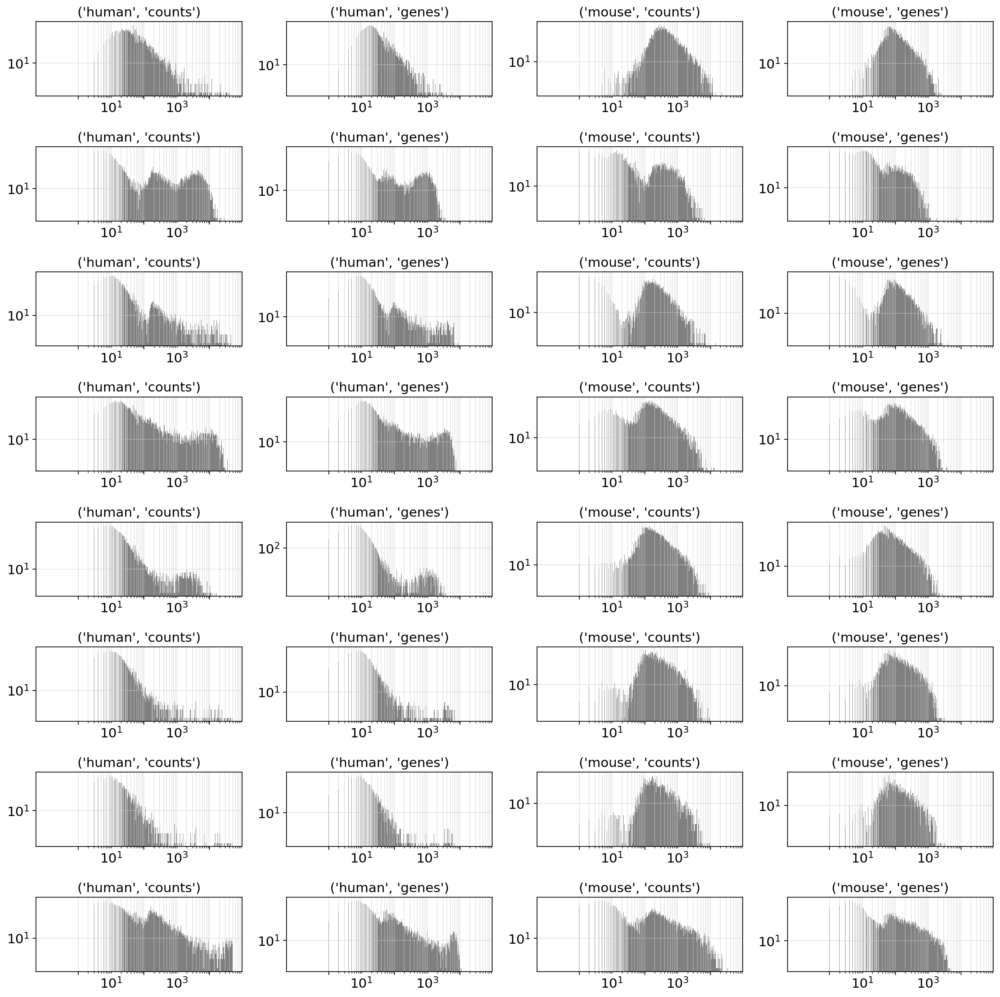

In [19]:
fig, axes = plt.subplots(8,4,figsize=(15,15))
for exp, row in tqdm(zip(exps, axes),total=8):
    for tupe, i in zip(it.product(['human','mouse'],['counts','genes']),
                         range(4)):
        ax = row[i]
        adata = exps[exp]['adata_' + tupe[0]]
        if tupe[1] == 'counts': # get counts
            vals = sc.pp.filter_cells(adata, min_counts=0,inplace=False)[1] # total number of UMIs observed
        else:
            vals = sc.pp.filter_cells(adata, min_genes=0,inplace=False)[1] # total number of UMIs observed
        my_plot(ax, vals, tupe)
plt.tight_layout()

Various distributions. Trimodal, bimodal, and two unimodal distributions. Derek says we mostly want mouse cells in these experiments, with some human cells. For now, I'll just keep all the cells called to visualize them on the UMAP but later we may want to separate them out.

In [20]:
exps[0]['human_min_counts'] = 1e3
exps[0]['human_min_genes'] = 5e2

exps[0]['mouse_min_counts'] = 80
exps[0]['mouse_min_genes'] = 20

exps[1]['human_min_counts'] = 70
exps[1]['human_min_genes'] = 30

exps[1]['mouse_min_counts'] = 1e2
exps[1]['mouse_min_genes'] = 50

exps[2]['human_min_counts'] = 1e2
exps[2]['human_min_genes'] = 60

exps[2]['mouse_min_counts'] = 50
exps[2]['mouse_min_genes'] = 20

exps[3]['human_min_counts'] = 2e3
exps[3]['human_min_genes'] = 1e3

exps[3]['mouse_min_counts'] = 50
exps[3]['mouse_min_genes'] = 30

exps[4]['human_min_counts'] = 8e2
exps[4]['human_min_genes'] = 3e2

exps[4]['mouse_min_counts'] = 30
exps[4]['mouse_min_genes'] = 10

exps[5]['human_min_counts'] = 3e2
exps[5]['human_min_genes'] = 2e2

exps[5]['mouse_min_counts'] = 30
exps[5]['mouse_min_genes'] = 20

exps[6]['human_min_counts'] = 3e2
exps[6]['human_min_genes'] = 2e2

exps[6]['mouse_min_counts'] = 30
exps[6]['mouse_min_genes'] = 20

exps[7]['human_min_counts'] = 1e2
exps[7]['human_min_genes'] = 4e1

exps[7]['mouse_min_counts'] = 6e1
exps[7]['mouse_min_genes'] = 4e1

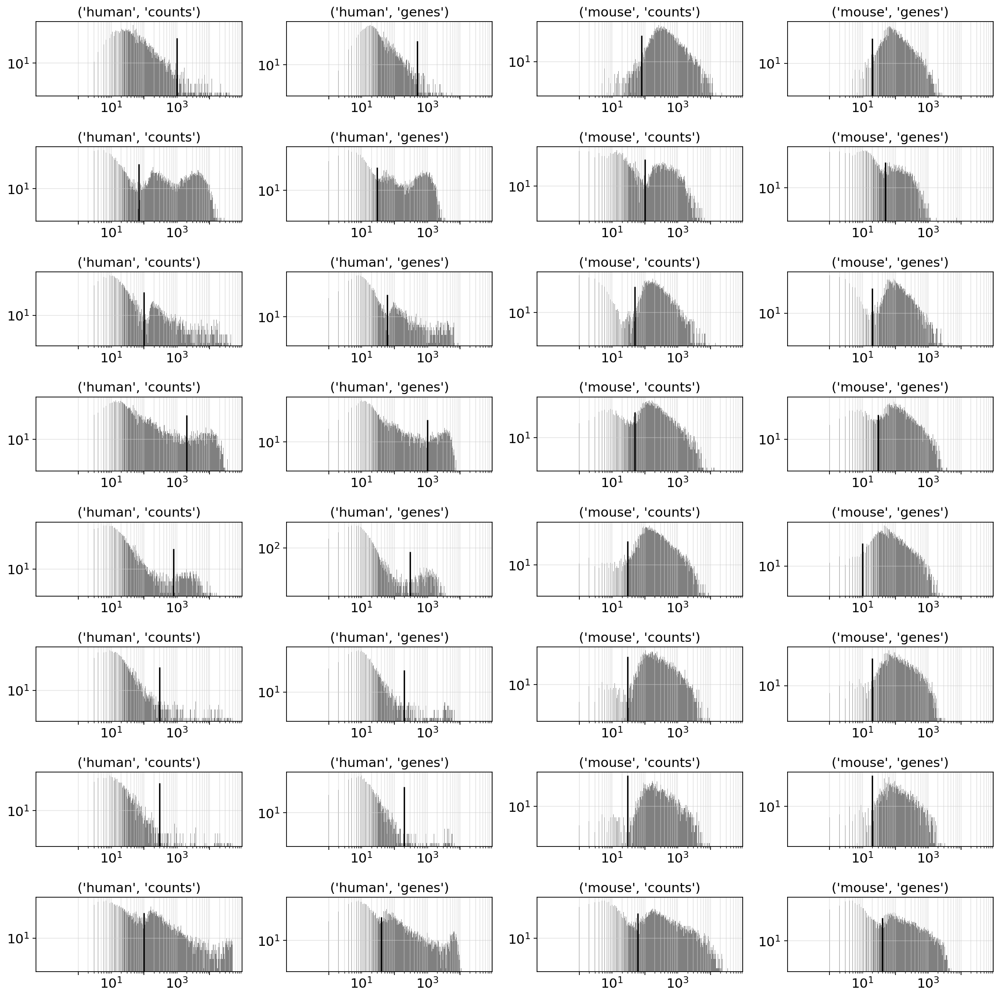

In [21]:
fig, axes = plt.subplots(8,4,figsize=(15,15))
for exp, row in tqdm(zip(exps, axes),total=8):
    for tupe, i in zip(it.product(['human','mouse'],['counts','genes']),
                         range(4)):
        ax = row[i]
        adata = exps[exp]['adata_' + tupe[0]]
        if tupe[1] == 'counts': # get counts
            vals = sc.pp.filter_cells(adata, min_counts=0,inplace=False)[1] # total number of UMIs observed
        else:
            vals = sc.pp.filter_cells(adata, min_genes=0,inplace=False)[1] # total number of UMIs observed
        my_plot(ax, vals, tupe, exps[exp]['_min_'.join([tupe[0],tupe[1]])],max_y=70)
plt.tight_layout()

In [22]:
for exp in exps:
    exps[exp]['org_df'] = pd.DataFrame(index=exps[exp]['adata'].obs_names)
    
    exps[exp]['org_df']['human_cells_counts'] = sc.pp.filter_cells(exps[exp]['adata_human'],min_counts=exps[exp]['human_min_counts'],inplace=False)[0]
    exps[exp]['org_df']['human_cells_genes'] = sc.pp.filter_cells(exps[exp]['adata_human'],min_counts=exps[exp]['human_min_genes'],inplace=False)[0]
    
    exps[exp]['org_df']['mouse_cells_counts'] = sc.pp.filter_cells(exps[exp]['adata_mouse'],min_counts=exps[exp]['mouse_min_counts'],inplace=False)[0]
    exps[exp]['org_df']['mouse_cells_genes'] = sc.pp.filter_cells(exps[exp]['adata_mouse'],min_counts=exps[exp]['mouse_min_genes'],inplace=False)[0]

filtered out 8829 cells that have less than 1000.0 counts
filtered out 8660 cells that have less than 500.0 counts
filtered out 291 cells that have less than 80 counts
filtered out 39 cells that have less than 20 counts
filtered out 3517 cells that have less than 70 counts
filtered out 3028 cells that have less than 30 counts
filtered out 4192 cells that have less than 100.0 counts
filtered out 3662 cells that have less than 50 counts
filtered out 6538 cells that have less than 100.0 counts
filtered out 6260 cells that have less than 60 counts
filtered out 1176 cells that have less than 50 counts
filtered out 1004 cells that have less than 20 counts
filtered out 11507 cells that have less than 2000.0 counts
filtered out 11209 cells that have less than 1000.0 counts
filtered out 2180 cells that have less than 50 counts
filtered out 1574 cells that have less than 30 counts
filtered out 14539 cells that have less than 800.0 counts
filtered out 14421 cells that have less than 300.0 counts


In [23]:
for exp in exps:
    human = (exps[exp]['org_df']['human_cells_counts'] == True) & (exps[exp]['org_df']['human_cells_genes'] == True) & \
    (exps[exp]['org_df']['mouse_cells_counts'] == False) & (exps[exp]['org_df']['mouse_cells_genes'] == False)
    
    mouse = (exps[exp]['org_df']['mouse_cells_counts'] == True) & (exps[exp]['org_df']['mouse_cells_genes'] == True) & \
    (exps[exp]['org_df']['human_cells_counts'] == False) & (exps[exp]['org_df']['human_cells_genes'] == False)
    
    
    exps[exp]['adata_human'] = exps[exp]['adata_human'][human]
    exps[exp]['adata_mouse'] = exps[exp]['adata_mouse'][mouse]


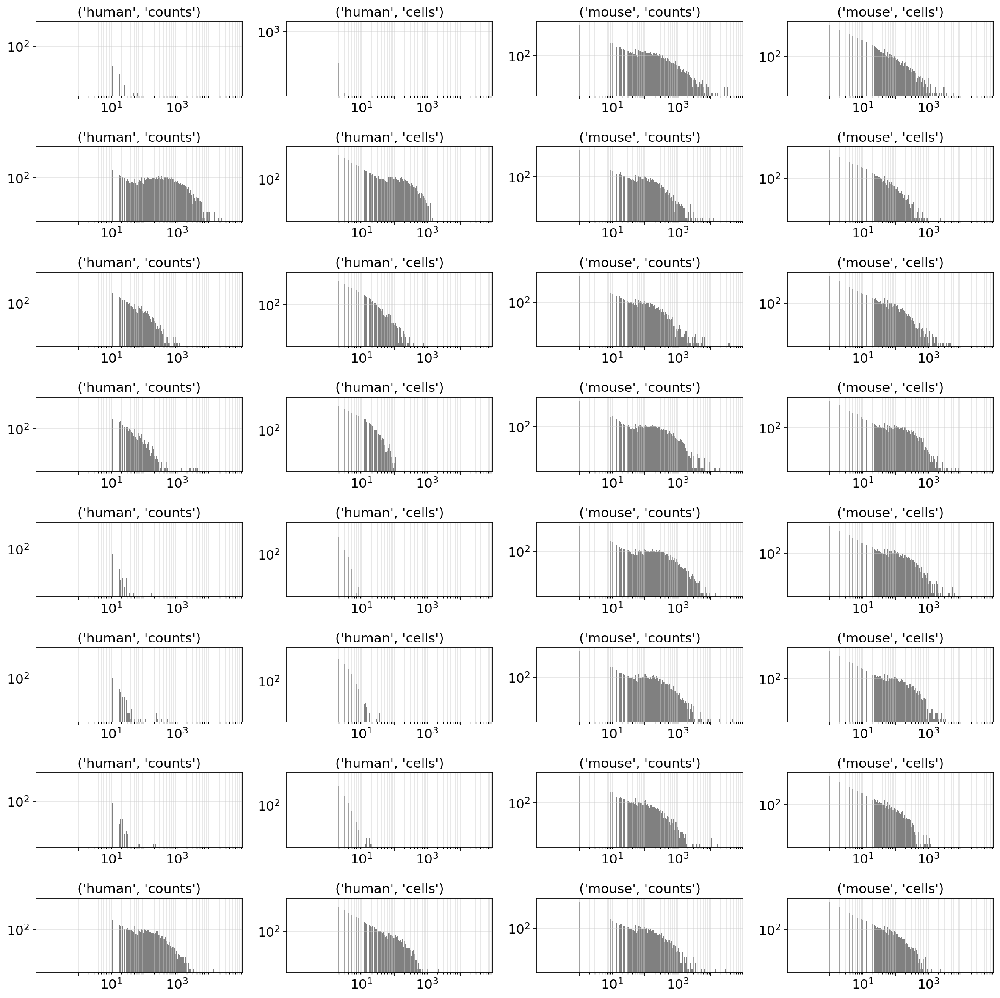

In [24]:
fig, axes = plt.subplots(8,4,figsize=(15,15))
for exp, row in tqdm(zip(exps, axes),total=8):
    for tupe, i in zip(it.product(['human','mouse'],['counts','cells']),
                         range(4)):
        ax = row[i]
        adata = exps[exp]['adata_' + tupe[0]]
        if tupe[1] == 'counts': # get counts
            vals = sc.pp.filter_genes(adata, min_counts=0,inplace=False)[1] # total number of UMIs observed
        else:
            vals = sc.pp.filter_genes(adata, min_cells=0,inplace=False)[1] # total number of UMIs observed
        my_plot(ax, vals, tupe)
plt.tight_layout()

In [25]:
for exp in exps:
    sc.pp.filter_genes(exps[exp]['adata_human'], min_counts=60,inplace=True)
    sc.pp.filter_genes(exps[exp]['adata_human'], min_cells=60,inplace=True)
    
    sc.pp.filter_genes(exps[exp]['adata_mouse'], min_counts=60,inplace=True)
    sc.pp.filter_genes(exps[exp]['adata_mouse'], min_cells=60,inplace=True)

Trying to set attribute `.var` of view, making a copy.
Trying to set attribute `.var` of view, making a copy.
Trying to set attribute `.var` of view, making a copy.
Trying to set attribute `.var` of view, making a copy.


filtered out 65474 genes that are detected in less than 60 counts
filtered out 2 genes that are detected in less than 60 cells
filtered out 43931 genes that are detected in less than 60 counts
filtered out 7761 genes that are detected in less than 60 cells
filtered out 53961 genes that are detected in less than 60 counts
filtered out 4273 genes that are detected in less than 60 cells
filtered out 50566 genes that are detected in less than 60 counts


Trying to set attribute `.var` of view, making a copy.
Trying to set attribute `.var` of view, making a copy.
Trying to set attribute `.var` of view, making a copy.
Trying to set attribute `.var` of view, making a copy.


filtered out 3679 genes that are detected in less than 60 cells
filtered out 63543 genes that are detected in less than 60 counts
filtered out 1317 genes that are detected in less than 60 cells
filtered out 50015 genes that are detected in less than 60 counts
filtered out 2025 genes that are detected in less than 60 cells
filtered out 64301 genes that are detected in less than 60 counts
filtered out 1021 genes that are detected in less than 60 cells
filtered out 46675 genes that are detected in less than 60 counts
filtered out 1707 genes that are detected in less than 60 cells
filtered out 65469 genes that are detected in less than 

Trying to set attribute `.var` of view, making a copy.
Trying to set attribute `.var` of view, making a copy.
Trying to set attribute `.var` of view, making a copy.
Trying to set attribute `.var` of view, making a copy.


60 counts
filtered out 7 genes that are detected in less than 60 cells
filtered out 46048 genes that are detected in less than 60 counts
filtered out 3188 genes that are detected in less than 60 cells
filtered out 65460 genes that are detected in less than 60 counts
filtered out 16 genes that are detected in less than 60 cells
filtered out 47483 genes that are detected in less than 60 counts


Trying to set attribute `.var` of view, making a copy.
Trying to set attribute `.var` of view, making a copy.
Trying to set attribute `.var` of view, making a copy.
Trying to set attribute `.var` of view, making a copy.


filtered out 2404 genes that are detected in less than 60 cells
filtered out 65464 genes that are detected in less than 60 counts
filtered out 12 genes that are detected in less than 60 cells
filtered out 50186 genes that are detected in less than 60 counts
filtered out 2927 genes that are detected in less than 60 cells
filtered out 59357 genes that are detected in less than 60 counts
filtered out 3496 genes that are detected in less than 60 cells
filtered out 49742 genes that are detected in less than 60 counts
filtered out 3058 genes that are detected in less than 60 cells


In [26]:
# with open('/myvol/data2/data/pkls/exps.pkl','wb') as file:
#     pkl.dump(exps,file)

In [20]:
with open('/myvol/data2/data/pkls/exps.pkl','rb') as file:
    exps = pkl.load(file)

### Mitochondrial Reads

Just use the first sample to get mitochondrial gene names
# TODO: does it make sense to do this *after* the filtering that I've already done, or before?

In [21]:
for exp in exps:
    genelist_human = exps[exp]['adata_human'].var_names.tolist()
    genelist_mouse = exps[exp]['adata_mouse'].var_names.tolist()

    mito_genes_names_human = [gn for gn in genelist_human if gn.startswith('MT-')]
    mito_genes_names_mouse = [gn for gn in genelist_mouse if gn.startswith('mt-')]

    mito_genes_names_all = mito_genes_names_human + mito_genes_names_mouse

    exps[exp]['mito_genes_human'] = [genelist_human.index(gn) for gn in mito_genes_names_human]
    exps[exp]['mito_genes_mouse'] = [genelist_mouse.index(gn) for gn in mito_genes_names_mouse]

Store percent mito in each sample:

In [22]:
for exp in exps:
    exps[exp]['adata_mouse'].obs['percent_mito'] = np.ravel(np.sum(exps[exp]['adata_mouse'][:, exps[exp]['mito_genes_mouse']].X, axis=1)) / np.ravel(np.sum(exps[exp]['adata_mouse'].X, axis=1))

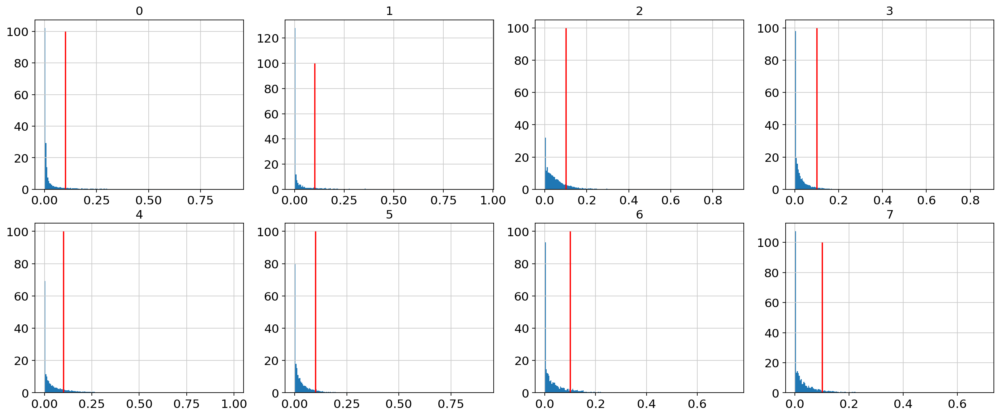

In [23]:
fig, axes = plt.subplots(2,4,figsize=(20,8))
for exp, ax in zip(exps,np.ravel(axes)):
    ax.hist(exps[exp]['adata_mouse'].obs['percent_mito'].values,bins=200,density=True)
    ax.set_title(exp)
    ax.vlines(0.1,0,100,color='r')

In [24]:
for exp in exps:
    exps[exp]['adata_mouse'] = exps[exp]['adata_mouse'][exps[exp]['adata_mouse'].obs['percent_mito'] < 0.1].copy()

### Dimensionality Reduction and UMAP

In [26]:
for exp in exps:
    print([i for i in exps[exp]['adata_mouse'].var_names if i.startswith('mt-')])

['mt-Nd1', 'mt-Nd2', 'mt-Co1', 'mt-Co2', 'mt-Atp8', 'mt-Atp6', 'mt-Co3', 'mt-Nd3', 'mt-Nd4', 'mt-Nd5', 'mt-Cytb']
['mt-Nd1', 'mt-Nd2', 'mt-Co1', 'mt-Nd4', 'mt-Nd5', 'mt-Cytb']
['mt-Nd1', 'mt-Nd2', 'mt-Co1', 'mt-Co2', 'mt-Atp6', 'mt-Co3', 'mt-Nd3', 'mt-Nd4', 'mt-Nd5', 'mt-Nd6', 'mt-Cytb']
['mt-Nd1', 'mt-Nd2', 'mt-Co1', 'mt-Co2', 'mt-Atp6', 'mt-Co3', 'mt-Nd3', 'mt-Nd4', 'mt-Nd5', 'mt-Nd6', 'mt-Cytb']
['mt-Nd1', 'mt-Nd2', 'mt-Co1', 'mt-Co2', 'mt-Atp8', 'mt-Atp6', 'mt-Co3', 'mt-Nd3', 'mt-Nd4', 'mt-Nd5', 'mt-Nd6', 'mt-Cytb']
['mt-Nd1', 'mt-Nd2', 'mt-Co1', 'mt-Co2', 'mt-Atp6', 'mt-Co3', 'mt-Nd3', 'mt-Nd4', 'mt-Nd5', 'mt-Nd6', 'mt-Cytb']
['mt-Nd1', 'mt-Nd2', 'mt-Co1', 'mt-Nd3', 'mt-Nd4', 'mt-Nd5', 'mt-Cytb']
['mt-Nd1', 'mt-Nd2', 'mt-Co1', 'mt-Co2', 'mt-Atp6', 'mt-Co3', 'mt-Nd3', 'mt-Nd4', 'mt-Nd5', 'mt-Cytb']


In [27]:
def process1(adata):
    sc.pp.log1p(adata)
    sc.pp.normalize_per_cell(adata)
    return adata

In [28]:
for exp in exps:
    process1(exps[exp]['adata_mouse'])

    normalizing by total count per cell
        finished (0:00:00.01): normalized adata.X and added
        'n_counts', counts per cell before normalization (adata.obs)
    normalizing by total count per cell
        finished (0:00:00.00): normalized adata.X and added
        'n_counts', counts per cell before normalization (adata.obs)
    normalizing by total count per cell
        finished (0:00:00.01): normalized adata.X and added
        'n_counts', counts per cell before normalization (adata.obs)
    normalizing by total count per cell
        finished (0:00:00.02): normalized adata.X and added
        'n_counts', counts per cell before normalization (adata.obs)
    normalizing by total count per cell
        finished (0:00:00.02): normalized adata.X and added
        'n_counts', counts per cell before normalization (adata.obs)
    normalizing by total count per cell
        finished (0:00:00.01): normalized adata.X and added
        'n_counts', counts per cell before normalizatio

In [29]:
def process2_check(adata,min_mean=0.0125):    # Extract out highly variable genes, but don't subset just yet.
    hv_adata = adata.copy()
    sc.pp.highly_variable_genes(hv_adata, flavor='cell_ranger',inplace=True, min_mean=min_mean)
    sc.pl.highly_variable_genes(hv_adata,log=True)

    extracting highly variable genes
        finished (0:00:00.25)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


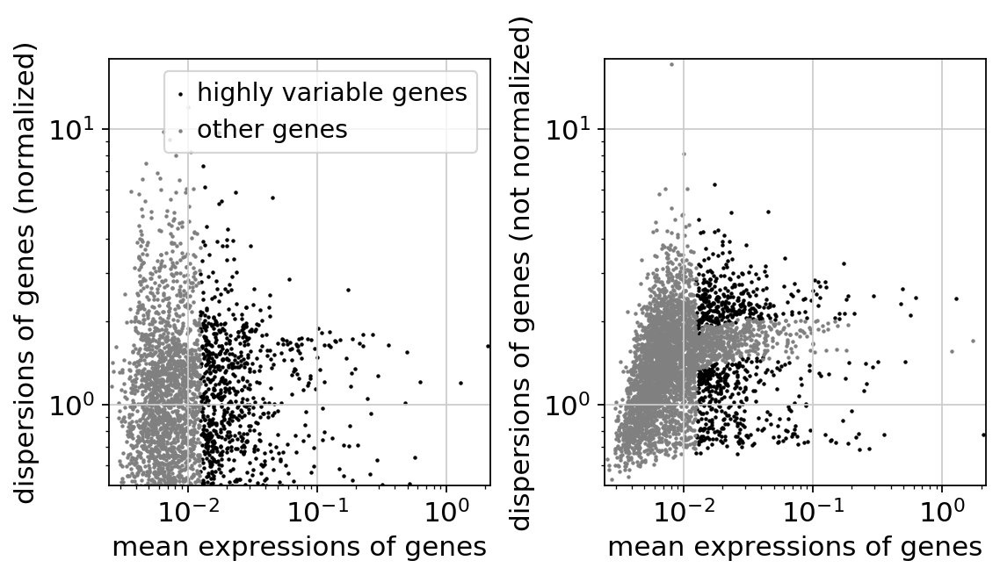

    extracting highly variable genes
        finished (0:00:00.07)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


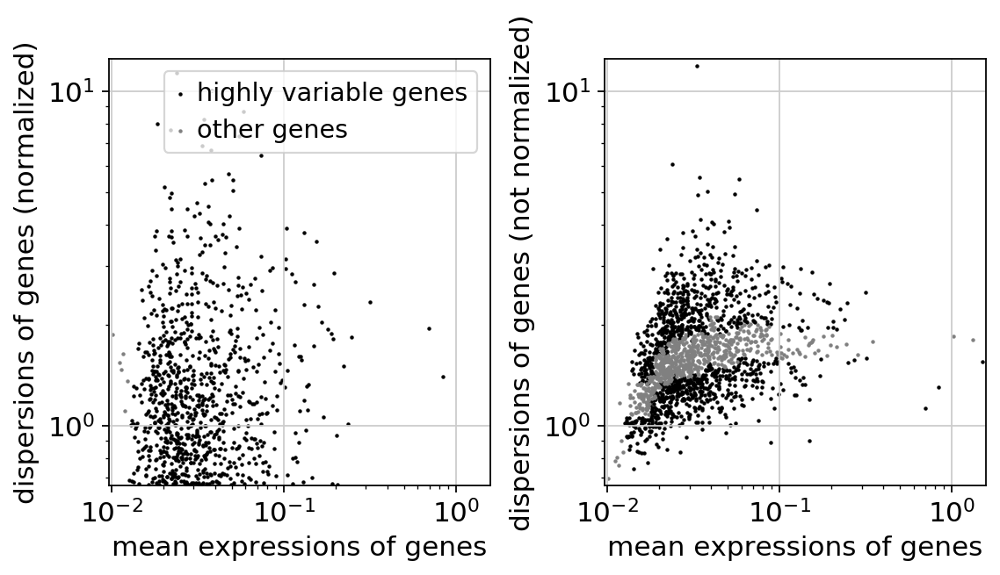

    extracting highly variable genes
        finished (0:00:00.13)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


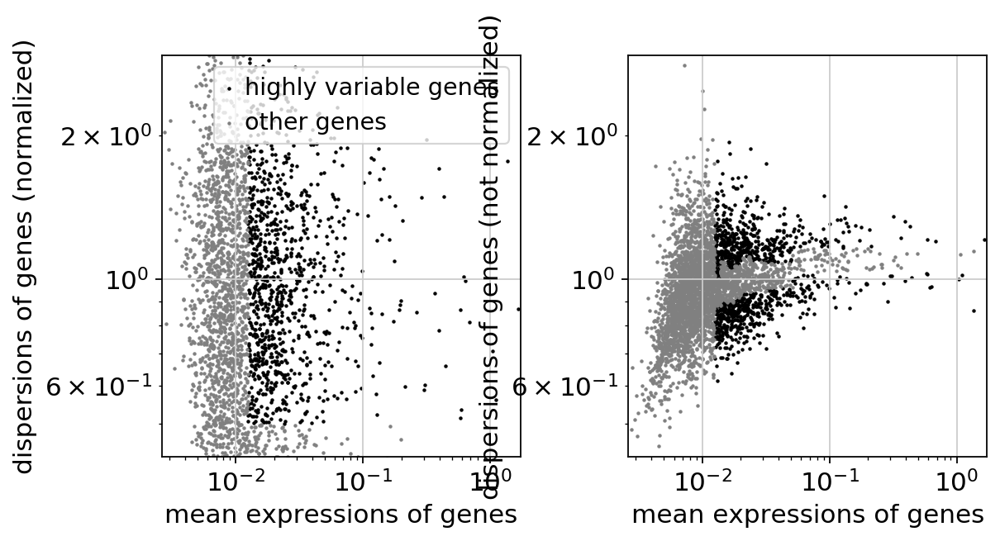

    extracting highly variable genes
        finished (0:00:00.37)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


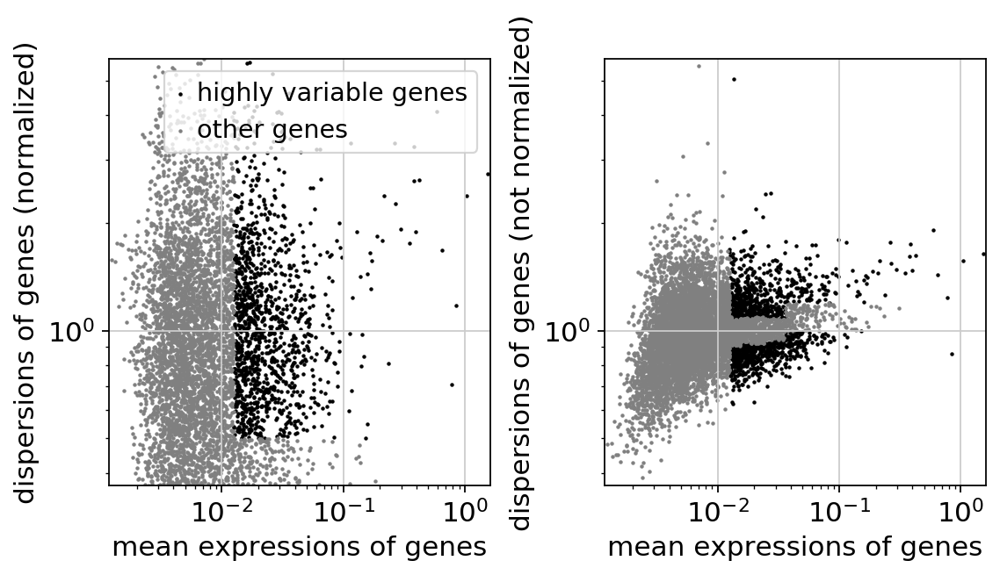

    extracting highly variable genes
        finished (0:00:00.21)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


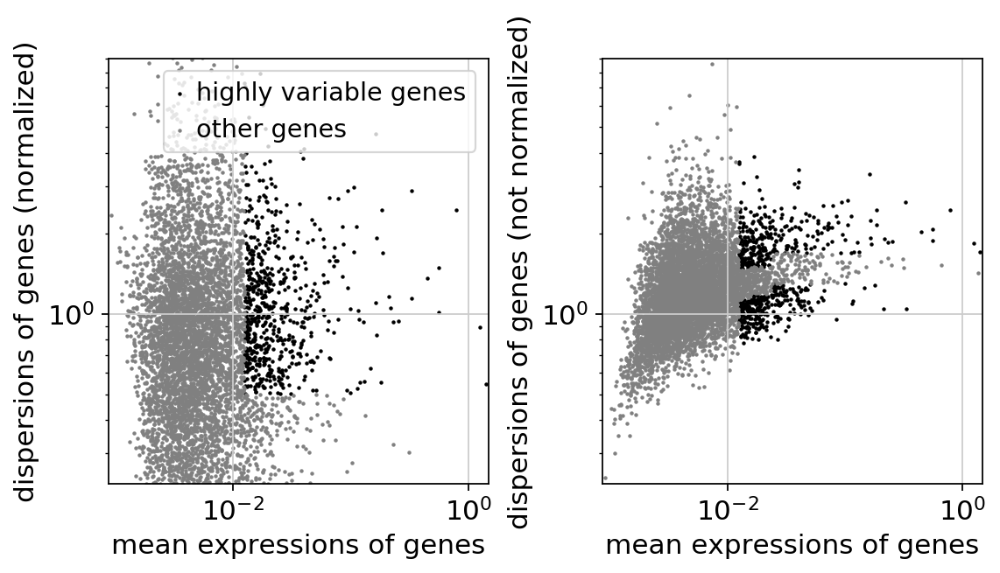

    extracting highly variable genes
        finished (0:00:00.19)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


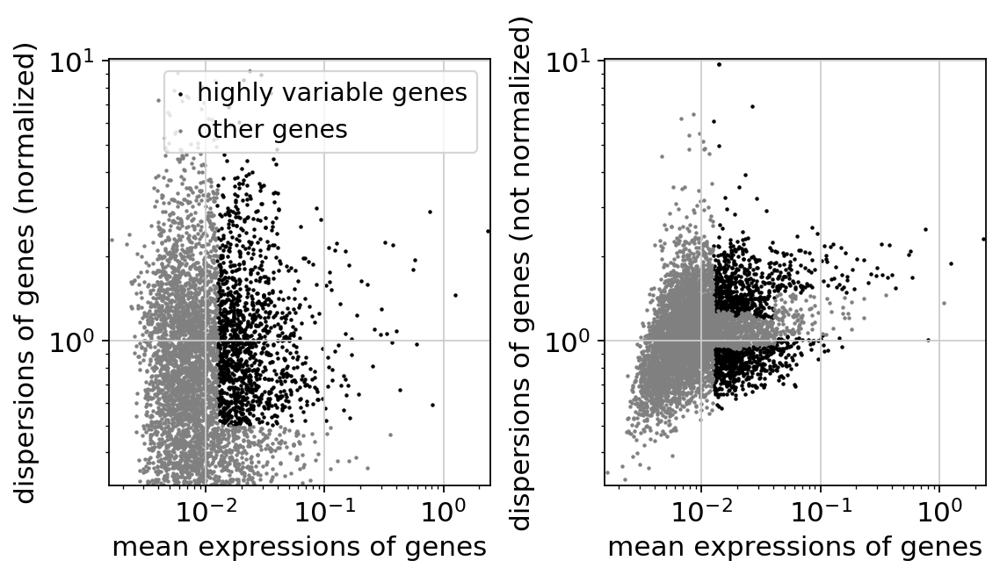

    extracting highly variable genes
        finished (0:00:00.10)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


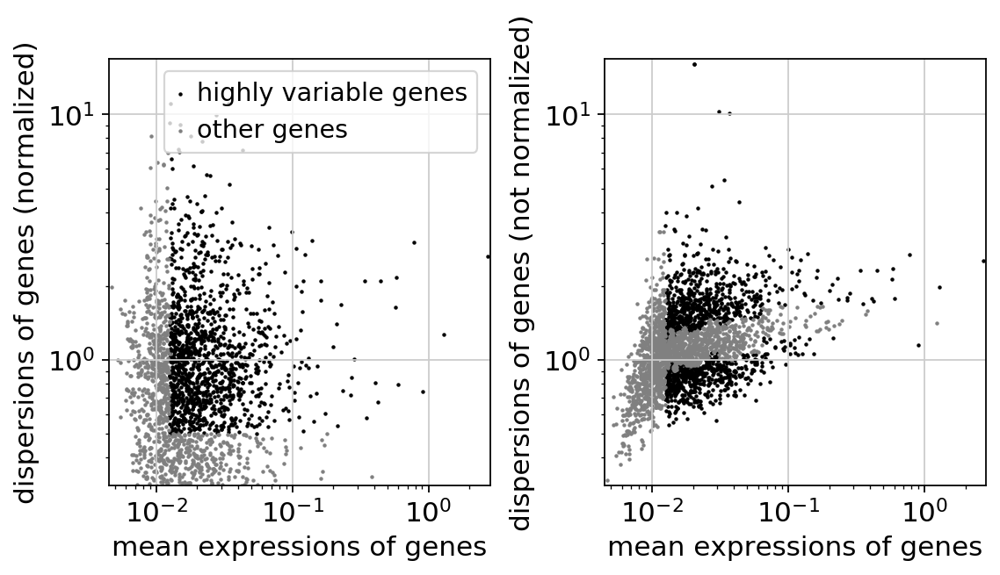

    extracting highly variable genes
        finished (0:00:00.25)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


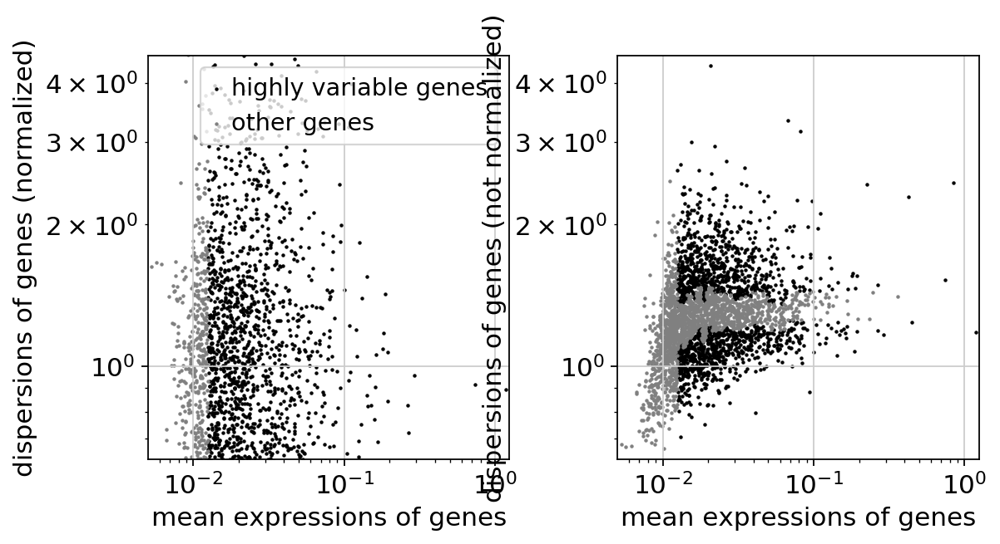

In [30]:
for exp in exps:
    process2_check(exps[exp]['adata_mouse'])

In [31]:
min_means = [0.006, 0.02, 0.006, 0.003, 0.003, 0.005, 0.01]

    extracting highly variable genes
        finished (0:00:00.14)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


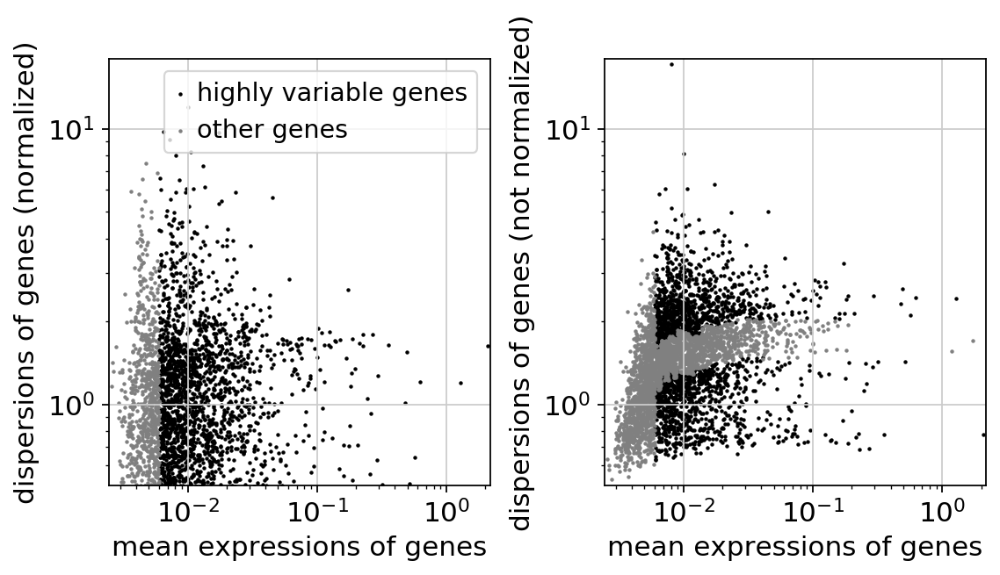

    extracting highly variable genes
        finished (0:00:00.07)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


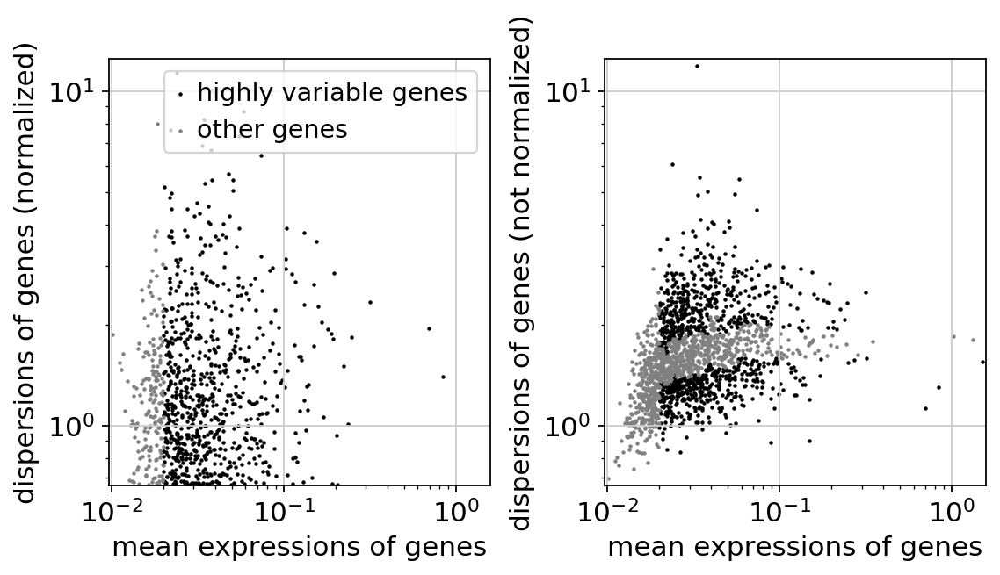

    extracting highly variable genes
        finished (0:00:00.13)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


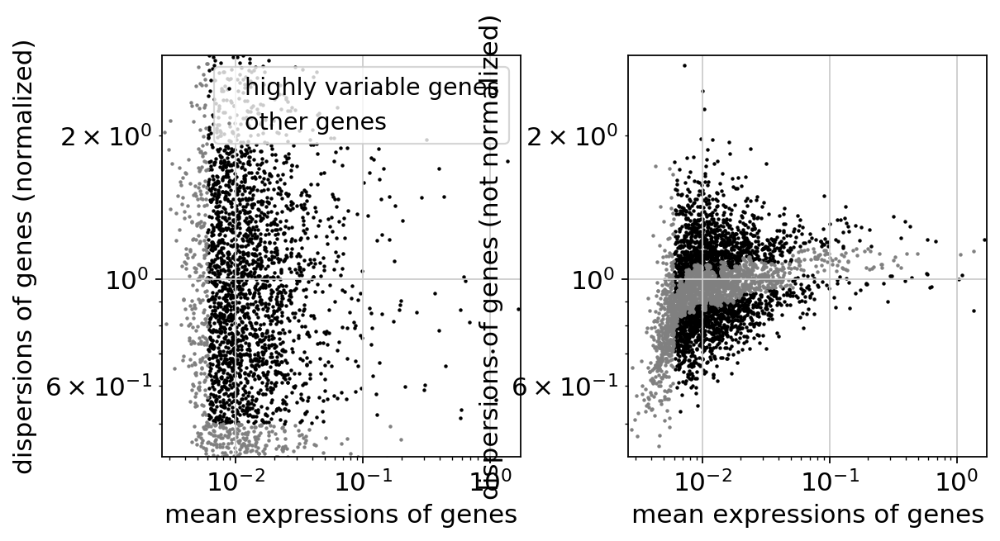

    extracting highly variable genes
        finished (0:00:00.24)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


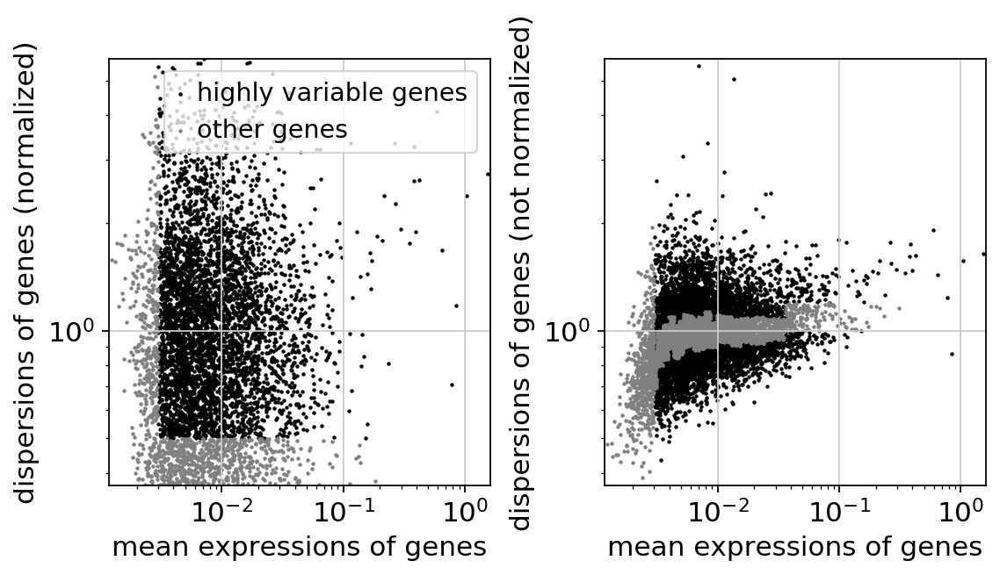

    extracting highly variable genes
        finished (0:00:00.21)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


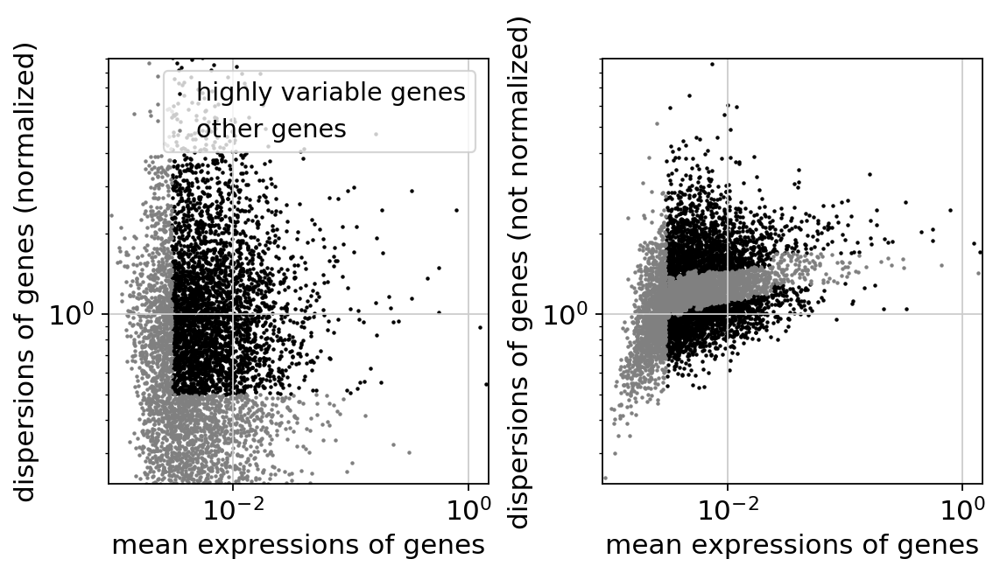

    extracting highly variable genes
        finished (0:00:00.19)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


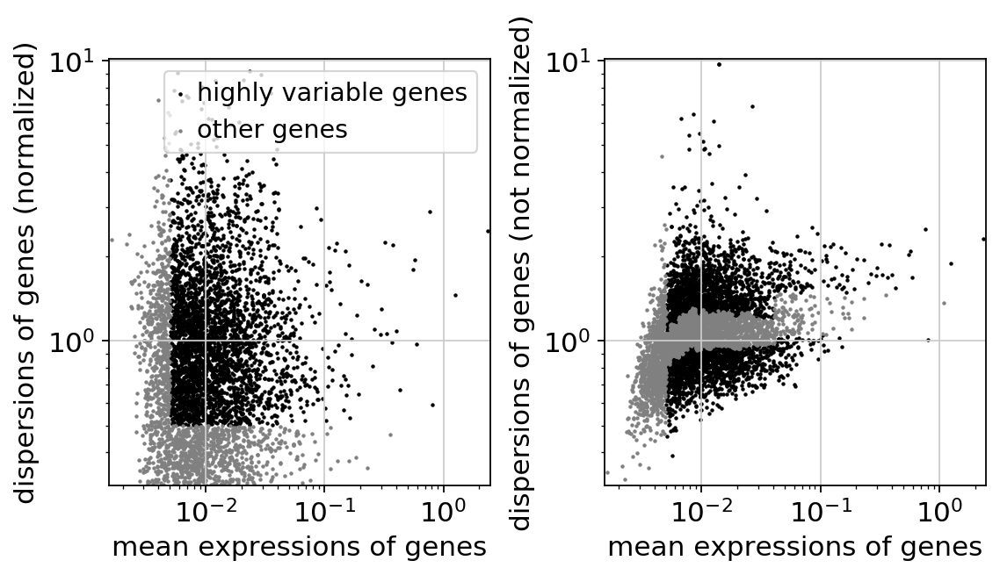

    extracting highly variable genes
        finished (0:00:00.10)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


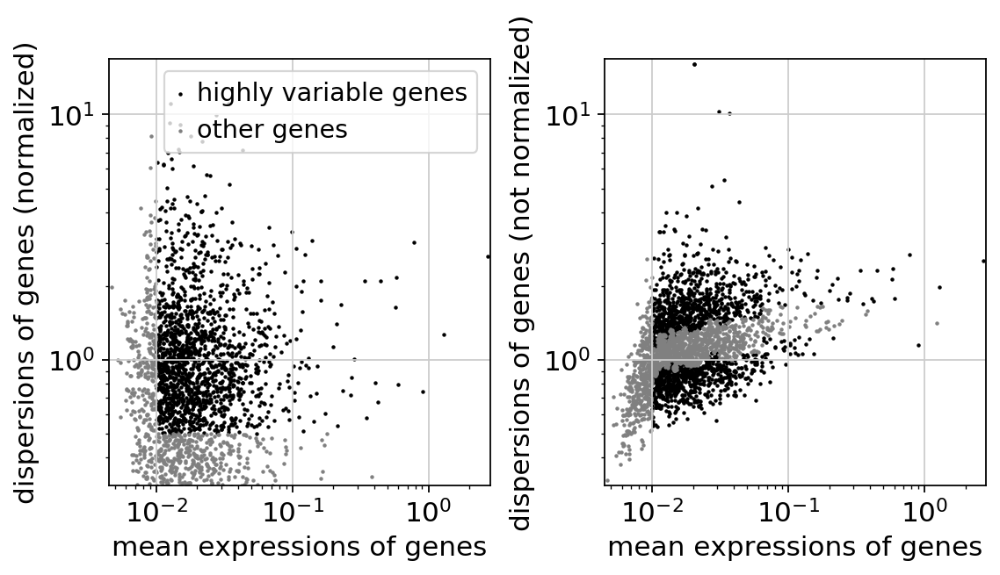

In [32]:
for exp, min_mean in zip(exps, min_means):
    process2_check(exps[exp]['adata_mouse'],min_mean=min_mean)

In [33]:
def process2(adata, min_mean):    # Extract out highly variable genes, but don't subset just yet.
    sc.pp.highly_variable_genes(adata, flavor='cell_ranger',inplace=True, subset=True, min_mean=min_mean)

In [34]:
for exp, min_mean in zip(exps, min_means):
    process2(exps[exp]['adata_mouse'],min_mean=min_mean)

    extracting highly variable genes
        finished (0:00:00.14)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)
    extracting highly variable genes
        finished (0:00:00.07)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)
    extracting highly variable genes
        finished (0:00:00.26)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)
    extracting highly variable genes
        finished (0:00:00.24)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_

How many highly-variable genes were detected out of the ~120k?

In [35]:
for exp in exps:
    print(len(exps[exp]['adata_mouse'].var_names))

1882
890
2173
4347
3300
3230
1515
3196


In [36]:
for exp in exps:
    print([i for i in exps[exp]['adata_mouse'].var_names if i.startswith('mt-')])

['mt-Nd1', 'mt-Nd2', 'mt-Co2', 'mt-Atp6', 'mt-Co3', 'mt-Nd3', 'mt-Nd4', 'mt-Cytb']
['mt-Cytb']
['mt-Nd2', 'mt-Co2', 'mt-Atp6', 'mt-Co3', 'mt-Nd5', 'mt-Nd6', 'mt-Cytb']
['mt-Nd1', 'mt-Nd2', 'mt-Co1', 'mt-Co3', 'mt-Nd4', 'mt-Nd5', 'mt-Nd6', 'mt-Cytb']
['mt-Nd3', 'mt-Nd6']
['mt-Nd1', 'mt-Nd2', 'mt-Co1', 'mt-Co3', 'mt-Nd4', 'mt-Nd5', 'mt-Nd6', 'mt-Cytb']
['mt-Nd1', 'mt-Nd2', 'mt-Co1', 'mt-Nd4', 'mt-Nd5']
['mt-Nd1', 'mt-Nd2', 'mt-Co1', 'mt-Co2', 'mt-Atp6', 'mt-Co3', 'mt-Nd3', 'mt-Nd4', 'mt-Nd5', 'mt-Cytb']


Cool, seems reasonable.

In [37]:
for exp in exps:
    sc.pp.regress_out(exps[exp]['adata_mouse'],['percent_mito','n_counts'],n_jobs=8)
    sc.pp.scale(exps[exp]['adata_mouse'], max_value=10)

regressing out ['percent_mito', 'n_counts']
    sparse input is densified and may lead to high memory use
    finished (0:00:15.44)
    ... clipping at max_value 10
regressing out ['percent_mito', 'n_counts']
    sparse input is densified and may lead to high memory use
    finished (0:00:00.83)
    ... clipping at max_value 10
regressing out ['percent_mito', 'n_counts']
    sparse input is densified and may lead to high memory use
    finished (0:00:13.56)
    ... clipping at max_value 10
regressing out ['percent_mito', 'n_counts']
    sparse input is densified and may lead to high memory use
    finished (0:00:35.32)
    ... clipping at max_value 10
regressing out ['percent_mito', 'n_counts']
    sparse input is densified and may lead to high memory use
    finished (0:00:32.10)
    ... clipping at max_value 10
regressing out ['percent_mito', 'n_counts']
    sparse input is densified and may lead to high memory use
    finished (0:00:21.46)
    ... clipping at max_value 10
regressing

In [42]:
# with open('/myvol/data2/data/pkls/exps.2.pkl','wb') as file:
#     pkl.dump(exps,file)

In [123]:
with open('/myvol/data2/data/pkls/exps.2.pkl','rb') as file:
    exps = pkl.load(file)

Note that scikit-learn's randomized PCA might not be exactly reproducible across different computational platforms. For exact reproducibility, choose `svd_solver='arpack'.` This will likely become the Scanpy default in the future.
computing PCA with n_comps = 50
computing PCA on highly variable genes
    finished (0:00:00.70)
    and added
    'X_pca', the PCA coordinates (adata.obs)
    'PC1', 'PC2', ..., the loadings (adata.var)
    'pca_variance', the variance / eigenvalues (adata.uns)
    'pca_variance_ratio', the variance ratio (adata.uns)


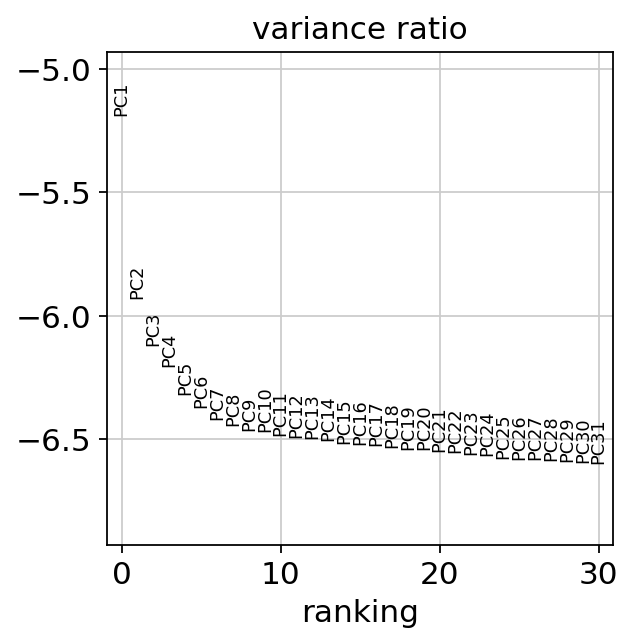

Note that scikit-learn's randomized PCA might not be exactly reproducible across different computational platforms. For exact reproducibility, choose `svd_solver='arpack'.` This will likely become the Scanpy default in the future.
computing PCA with n_comps = 50
computing PCA on highly variable genes
    finished (0:00:00.37)
    and added
    'X_pca', the PCA coordinates (adata.obs)
    'PC1', 'PC2', ..., the loadings (adata.var)
    'pca_variance', the variance / eigenvalues (adata.uns)
    'pca_variance_ratio', the variance ratio (adata.uns)


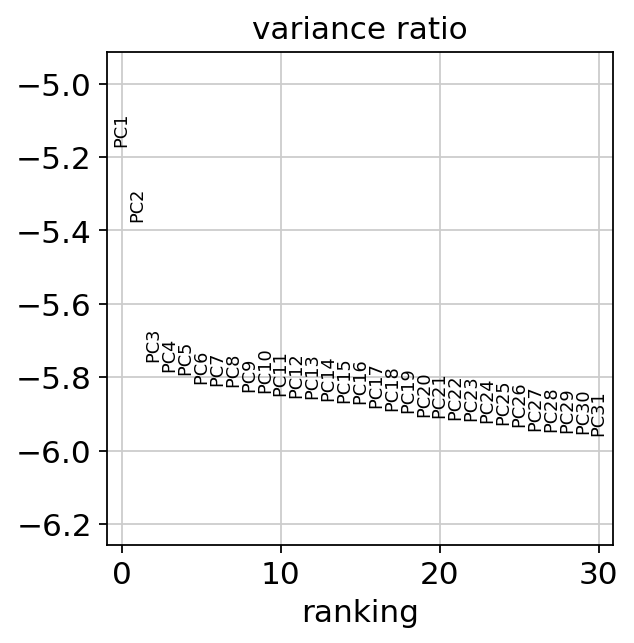

Note that scikit-learn's randomized PCA might not be exactly reproducible across different computational platforms. For exact reproducibility, choose `svd_solver='arpack'.` This will likely become the Scanpy default in the future.
computing PCA with n_comps = 50
computing PCA on highly variable genes
    finished (0:00:00.25)
    and added
    'X_pca', the PCA coordinates (adata.obs)
    'PC1', 'PC2', ..., the loadings (adata.var)
    'pca_variance', the variance / eigenvalues (adata.uns)
    'pca_variance_ratio', the variance ratio (adata.uns)


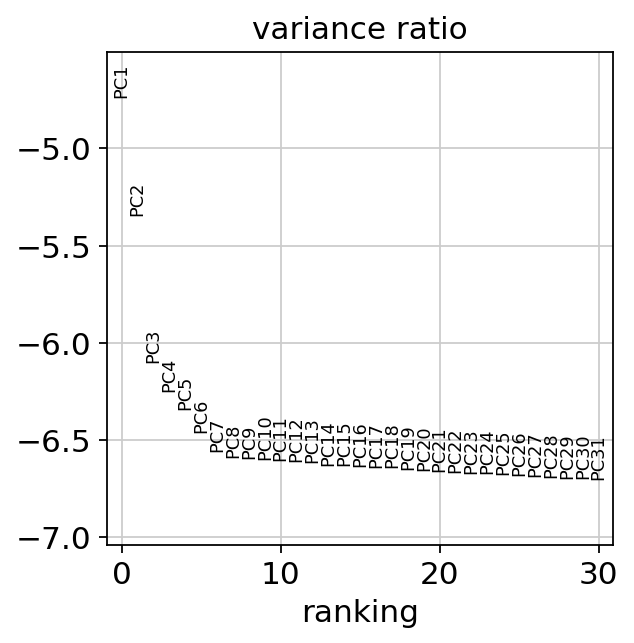

Note that scikit-learn's randomized PCA might not be exactly reproducible across different computational platforms. For exact reproducibility, choose `svd_solver='arpack'.` This will likely become the Scanpy default in the future.
computing PCA with n_comps = 50
computing PCA on highly variable genes
    finished (0:00:00.81)
    and added
    'X_pca', the PCA coordinates (adata.obs)
    'PC1', 'PC2', ..., the loadings (adata.var)
    'pca_variance', the variance / eigenvalues (adata.uns)
    'pca_variance_ratio', the variance ratio (adata.uns)


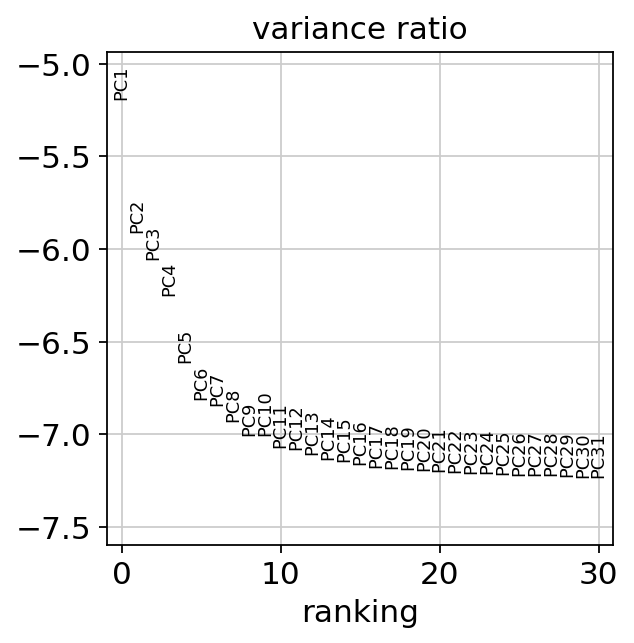

Note that scikit-learn's randomized PCA might not be exactly reproducible across different computational platforms. For exact reproducibility, choose `svd_solver='arpack'.` This will likely become the Scanpy default in the future.
computing PCA with n_comps = 50
computing PCA on highly variable genes
    finished (0:00:00.80)
    and added
    'X_pca', the PCA coordinates (adata.obs)
    'PC1', 'PC2', ..., the loadings (adata.var)
    'pca_variance', the variance / eigenvalues (adata.uns)
    'pca_variance_ratio', the variance ratio (adata.uns)


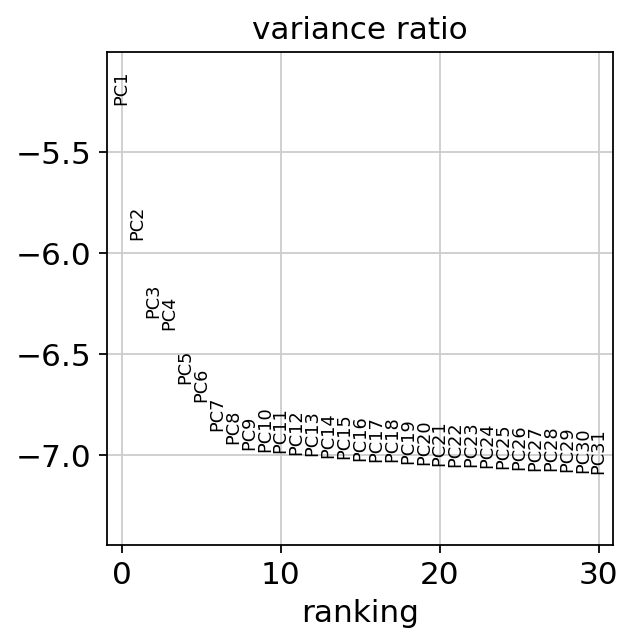

Note that scikit-learn's randomized PCA might not be exactly reproducible across different computational platforms. For exact reproducibility, choose `svd_solver='arpack'.` This will likely become the Scanpy default in the future.
computing PCA with n_comps = 50
computing PCA on highly variable genes
    finished (0:00:00.46)
    and added
    'X_pca', the PCA coordinates (adata.obs)
    'PC1', 'PC2', ..., the loadings (adata.var)
    'pca_variance', the variance / eigenvalues (adata.uns)
    'pca_variance_ratio', the variance ratio (adata.uns)


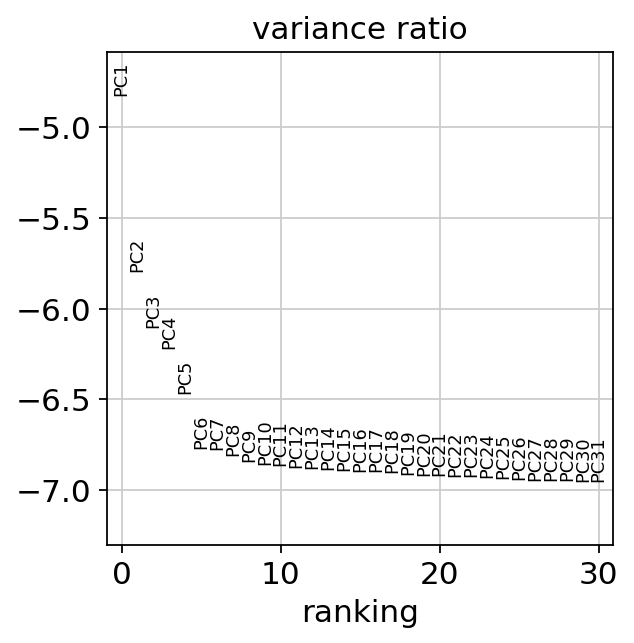

Note that scikit-learn's randomized PCA might not be exactly reproducible across different computational platforms. For exact reproducibility, choose `svd_solver='arpack'.` This will likely become the Scanpy default in the future.
computing PCA with n_comps = 50
computing PCA on highly variable genes
    finished (0:00:00.10)
    and added
    'X_pca', the PCA coordinates (adata.obs)
    'PC1', 'PC2', ..., the loadings (adata.var)
    'pca_variance', the variance / eigenvalues (adata.uns)
    'pca_variance_ratio', the variance ratio (adata.uns)


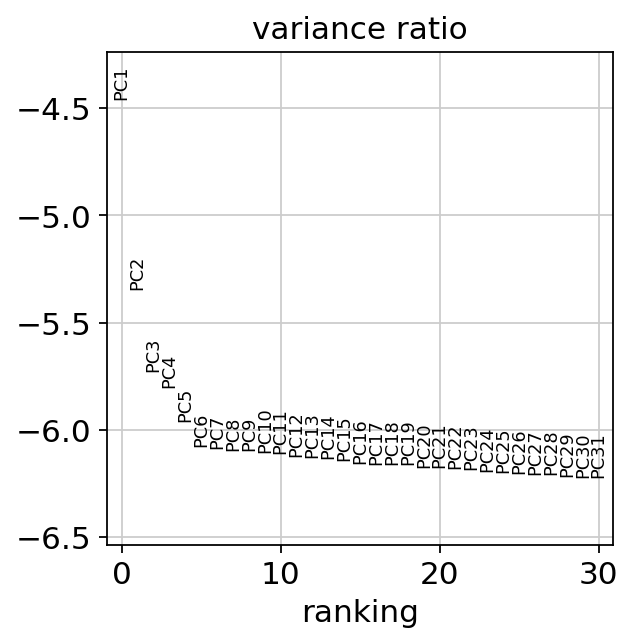

Note that scikit-learn's randomized PCA might not be exactly reproducible across different computational platforms. For exact reproducibility, choose `svd_solver='arpack'.` This will likely become the Scanpy default in the future.
computing PCA with n_comps = 50
    finished (0:00:00.21)
    and added
    'X_pca', the PCA coordinates (adata.obs)
    'PC1', 'PC2', ..., the loadings (adata.var)
    'pca_variance', the variance / eigenvalues (adata.uns)
    'pca_variance_ratio', the variance ratio (adata.uns)


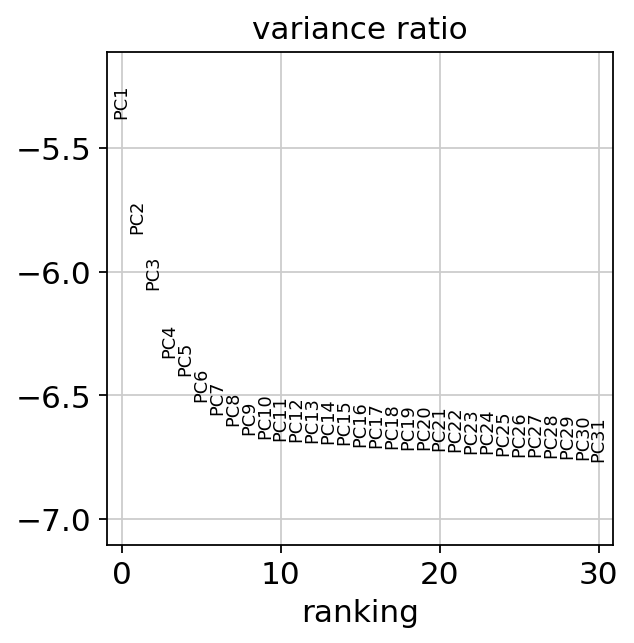

In [38]:
for exp in exps:
    sc.pp.pca(exps[exp]['adata_mouse'])
    sc.pl.pca_variance_ratio(exps[exp]['adata_mouse'],log=True)

In [39]:
npcs = [12, 7, 10, 16, 10, 10, 8, 12]

In [40]:
for exp, npc in zip(exps,npcs):
    warnings.filterwarnings('ignore')
    sc.pp.neighbors(exps[exp]['adata_mouse'],n_neighbors=10,n_pcs=npc) # numba warning outlined here is not to be of concern: https://github.com/lmcinnes/umap/issues/252
    warnings.filterwarnings('default')
    sc.tl.leiden(exps[exp]['adata_mouse'],resolution=0.3)
    sc.tl.umap(exps[exp]['adata_mouse'], min_dist=.05, spread=5, alpha=2)

computing neighbors
    using 'X_pca' with n_pcs = 12
    computed neighbors (0:00:12.17)
    computed connectivities (0:00:26.78)
    finished (0:00:00.15) --> added to `.uns['neighbors']`
    'distances', distances for each pair of neighbors
    'connectivities', weighted adjacency matrix
running Leiden clustering
    finished (0:00:08.00) --> found 2 clusters and added
    'leiden', the cluster labels (adata.obs, categorical)
computing UMAP
    using 'X_pca' with n_pcs = 12


/usr/local/lib/python3.6/dist-packages/umap/umap_.py:1054: RuntimeWarning: divide by zero encountered in power
  return 1.0 / (1.0 + a * x ** (2 * b))


	completed  0  /  500 epochs
	completed  50  /  500 epochs
	completed  100  /  500 epochs
	completed  150  /  500 epochs
	completed  200  /  500 epochs
	completed  250  /  500 epochs
	completed  300  /  500 epochs
	completed  350  /  500 epochs
	completed  400  /  500 epochs
	completed  450  /  500 epochs
    finished (0:01:35.64) --> added
    'X_umap', UMAP coordinates (adata.obsm)
computing neighbors
    using 'X_pca' with n_pcs = 7
    computed neighbors (0:00:00.17)
    computed connectivities (0:00:00.06)
    finished (0:00:00.00) --> added to `.uns['neighbors']`
    'distances', distances for each pair of neighbors
    'connectivities', weighted adjacency matrix
running Leiden clustering
    finished (0:00:00.35) --> found 3 clusters and added
    'leiden', the cluster labels (adata.obs, categorical)
computing UMAP
    using 'X_pca' with n_pcs = 7
	completed  0  /  500 epochs


/usr/local/lib/python3.6/dist-packages/umap/umap_.py:1054: RuntimeWarning: divide by zero encountered in power
  return 1.0 / (1.0 + a * x ** (2 * b))


	completed  50  /  500 epochs
	completed  100  /  500 epochs
	completed  150  /  500 epochs
	completed  200  /  500 epochs
	completed  250  /  500 epochs
	completed  300  /  500 epochs
	completed  350  /  500 epochs
	completed  400  /  500 epochs
	completed  450  /  500 epochs
    finished (0:00:05.38) --> added
    'X_umap', UMAP coordinates (adata.obsm)
computing neighbors
    using 'X_pca' with n_pcs = 10
    computed neighbors (0:00:00.56)
    computed connectivities (0:00:00.11)
    finished (0:00:00.00) --> added to `.uns['neighbors']`
    'distances', distances for each pair of neighbors
    'connectivities', weighted adjacency matrix
running Leiden clustering
    finished (0:00:00.62) --> found 5 clusters and added
    'leiden', the cluster labels (adata.obs, categorical)
computing UMAP
    using 'X_pca' with n_pcs = 10
	completed  0  /  500 epochs


/usr/local/lib/python3.6/dist-packages/umap/umap_.py:1054: RuntimeWarning: divide by zero encountered in power
  return 1.0 / (1.0 + a * x ** (2 * b))


	completed  50  /  500 epochs
	completed  100  /  500 epochs
	completed  150  /  500 epochs
	completed  200  /  500 epochs
	completed  250  /  500 epochs
	completed  300  /  500 epochs
	completed  350  /  500 epochs
	completed  400  /  500 epochs
	completed  450  /  500 epochs
    finished (0:00:10.91) --> added
    'X_umap', UMAP coordinates (adata.obsm)
computing neighbors
    using 'X_pca' with n_pcs = 16
    computed neighbors (0:00:04.08)
    computed connectivities (0:00:02.13)
    finished (0:00:00.00) --> added to `.uns['neighbors']`
    'distances', distances for each pair of neighbors
    'connectivities', weighted adjacency matrix
running Leiden clustering
    finished (0:00:01.45) --> found 7 clusters and added
    'leiden', the cluster labels (adata.obs, categorical)
computing UMAP
    using 'X_pca' with n_pcs = 16
	completed  0  /  500 epochs
	completed 

/usr/local/lib/python3.6/dist-packages/umap/umap_.py:1054: RuntimeWarning: divide by zero encountered in power
  return 1.0 / (1.0 + a * x ** (2 * b))


 50  /  500 epochs
	completed  100  /  500 epochs
	completed  150  /  500 epochs
	completed  200  /  500 epochs
	completed  250  /  500 epochs
	completed  300  /  500 epochs
	completed  350  /  500 epochs
	completed  400  /  500 epochs
	completed  450  /  500 epochs
    finished (0:00:20.10) --> added
    'X_umap', UMAP coordinates (adata.obsm)
computing neighbors
    using 'X_pca' with n_pcs = 10
    computed neighbors (0:00:02.12)
    computed connectivities (0:00:00.24)
    finished (0:00:00.00) --> added to `.uns['neighbors']`
    'distances', distances for each pair of neighbors
    'connectivities', weighted adjacency matrix
running Leiden clustering
    finished (0:00:02.71) --> found 5 clusters and added
    'leiden', the cluster labels (adata.obs, categorical)
computing UMAP
    using 'X_pca' with n_pcs = 10
	completed  0  /  200 epochs


/usr/local/lib/python3.6/dist-packages/umap/umap_.py:1054: RuntimeWarning: divide by zero encountered in power
  return 1.0 / (1.0 + a * x ** (2 * b))


	completed  20  /  200 epochs
	completed  40  /  200 epochs
	completed  60  /  200 epochs
	completed  80  /  200 epochs
	completed  100  /  200 epochs
	completed  120  /  200 epochs
	completed  140  /  200 epochs
	completed  160  /  200 epochs
	completed  180  /  200 epochs
    finished (0:00:09.66) --> added
    'X_umap', UMAP coordinates (adata.obsm)
computing neighbors
    using 'X_pca' with n_pcs = 10
    computed neighbors (0:00:01.03)
    computed connectivities (0:00:00.14)
    finished (0:00:00.01) --> added to `.uns['neighbors']`
    'distances', distances for each pair of neighbors
    'connectivities', weighted adjacency matrix
running Leiden clustering
    finished (0:00:00.81) --> found 5 clusters and added
    'leiden', the cluster labels (adata.obs, categorical)
computing UMAP
    using 'X_pca' with n_pcs = 10
	completed  0  /  500 epochs


/usr/local/lib/python3.6/dist-packages/umap/umap_.py:1054: RuntimeWarning: divide by zero encountered in power
  return 1.0 / (1.0 + a * x ** (2 * b))


	completed  50  /  500 epochs
	completed  100  /  500 epochs
	completed  150  /  500 epochs
	completed  200  /  500 epochs
	completed  250  /  500 epochs
	completed  300  /  500 epochs
	completed  350  /  500 epochs
	completed  400  /  500 epochs
	completed  450  /  500 epochs
    finished (0:00:13.35) --> added
    'X_umap', UMAP coordinates (adata.obsm)
computing neighbors
    using 'X_pca' with n_pcs = 8
    computed neighbors (0:00:00.16)
    computed connectivities (0:00:00.06)
    finished (0:00:00.00) --> added to `.uns['neighbors']`
    'distances', distances for each pair of neighbors
    'connectivities', weighted adjacency matrix
running Leiden clustering
    finished (0:00:00.43) --> found 5 clusters and added
    'leiden', the cluster labels (adata.obs, categorical)
computing UMAP
    using 'X_pca' with n_pcs = 8
	completed  0  /  500 epochs


/usr/local/lib/python3.6/dist-packages/umap/umap_.py:1054: RuntimeWarning: divide by zero encountered in power
  return 1.0 / (1.0 + a * x ** (2 * b))


	completed  50  /  500 epochs
	completed  100  /  500 epochs
	completed  150  /  500 epochs
	completed  200  /  500 epochs
	completed  250  /  500 epochs
	completed  300  /  500 epochs
	completed  350  /  500 epochs
	completed  400  /  500 epochs
	completed  450  /  500 epochs
    finished (0:00:05.65) --> added
    'X_umap', UMAP coordinates (adata.obsm)
computing neighbors
    using 'X_pca' with n_pcs = 12
    computed neighbors (0:00:00.25)
    computed connectivities (0:00:00.07)
    finished (0:00:00.00) --> added to `.uns['neighbors']`
    'distances', distances for each pair of neighbors
    'connectivities', weighted adjacency matrix
running Leiden clustering
    finished (0:00:00.37) --> found 5 clusters and added
    'leiden', the cluster labels (adata.obs, categorical)
computing UMAP
    using 'X_pca' with n_pcs = 12
	completed  0  /  500 epochs


/usr/local/lib/python3.6/dist-packages/umap/umap_.py:1054: RuntimeWarning: divide by zero encountered in power
  return 1.0 / (1.0 + a * x ** (2 * b))


	completed  50  /  500 epochs
	completed  100  /  500 epochs
	completed  150  /  500 epochs
	completed  200  /  500 epochs
	completed  250  /  500 epochs
	completed  300  /  500 epochs
	completed  350  /  500 epochs
	completed  400  /  500 epochs
	completed  450  /  500 epochs
    finished (0:00:07.82) --> added
    'X_umap', UMAP coordinates (adata.obsm)


In [41]:
for exp in exps:
    exps[exp]['label'] = exps[exp]['path'].split('/')[-1]

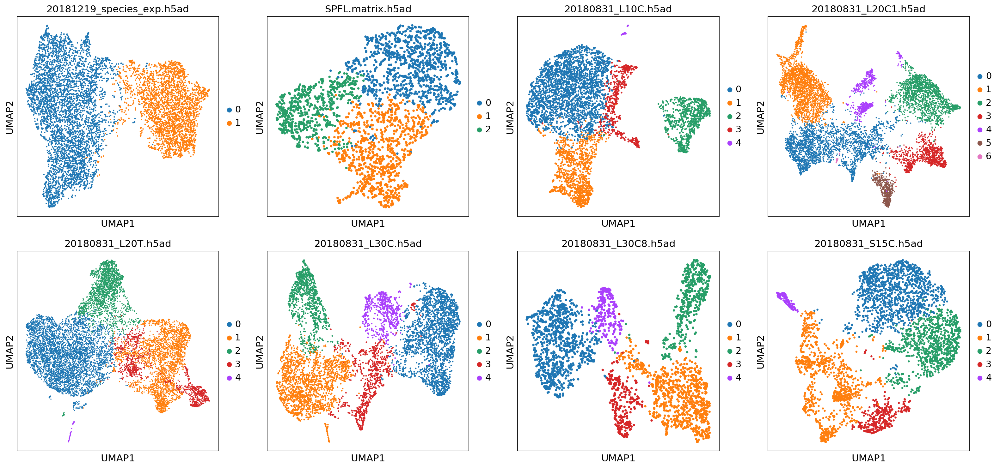

In [42]:
fig, axes = plt.subplots(2,4,figsize=(20,9.5))
for exp, ax in zip(exps, np.ravel(axes)):
    sc.pl.umap(exps[exp]['adata_mouse'],color='leiden',ax=ax, return_fig=False, show=False, title=exps[exp]['label'])
plt.tight_layout()

In [49]:
for exp in exps:
    print('mt-Nd6' in exps[exp]['adata_mouse'].var_names)

False
False
True
True
True
True
False
False


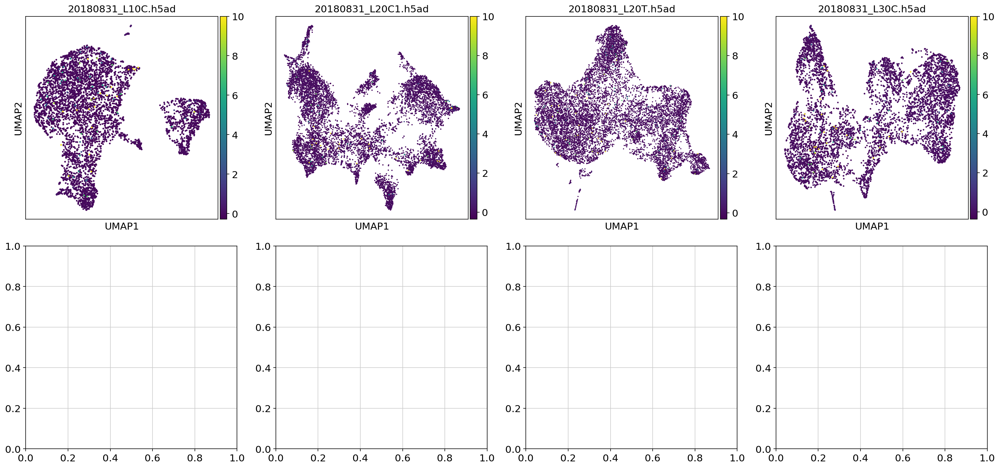

In [50]:
fig, axes = plt.subplots(2,4,figsize=(20,9.5))
for exp, ax in zip([2,3,4,5,], np.ravel(axes)):
    sc.pl.umap(exps[exp]['adata_mouse'],color='mt-Nd6',ax=ax, return_fig=False, show=False, title=exps[exp]['label'])
plt.tight_layout()

In [51]:
# with open('/myvol/data2/data/pkls/exps.3.pkl','wb') as file:
#     pkl.dump(exps,file)

In [4]:
with open('/myvol/data2/data/pkls/exps.3.pkl','rb') as file:
    exps = pkl.load(file)

/usr/local/lib/python3.6/dist-packages/scanpy/tools/_rank_genes_groups.py:222: RuntimeWarning: invalid value encountered in log2
  rankings_gene_logfoldchanges.append(np.log2(foldchanges[global_indices]))


0


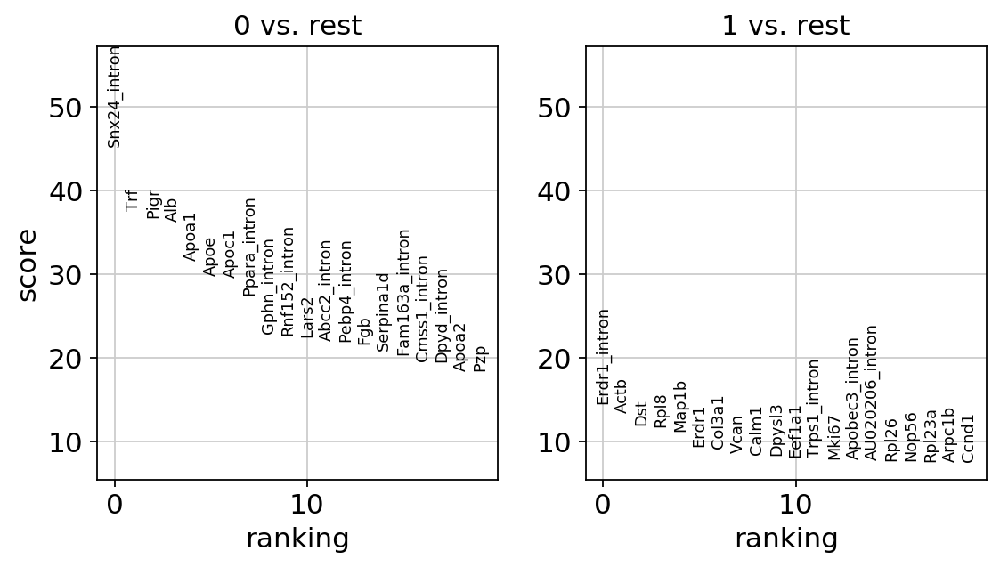

1


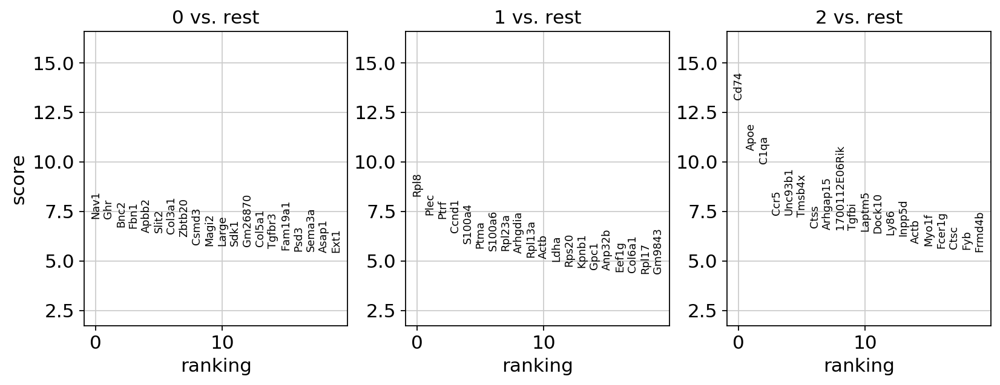

2


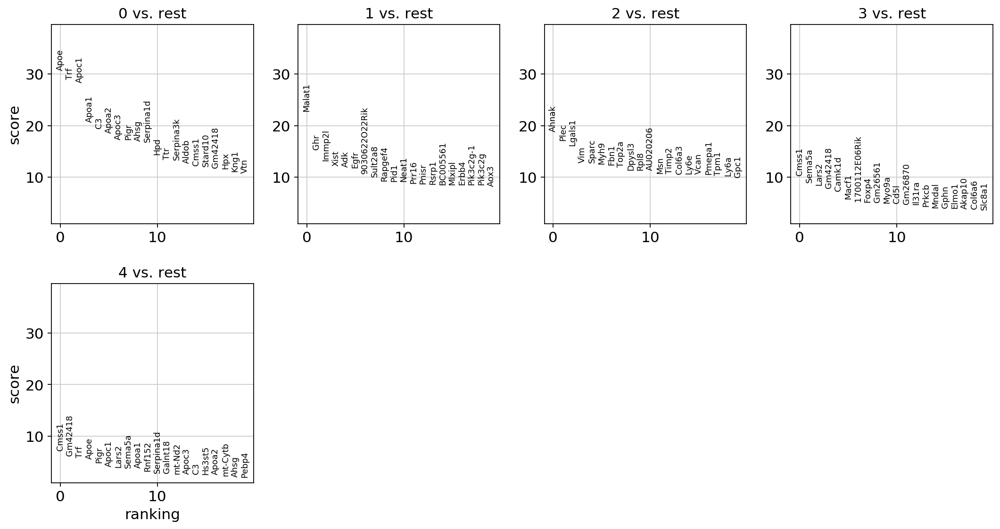

3


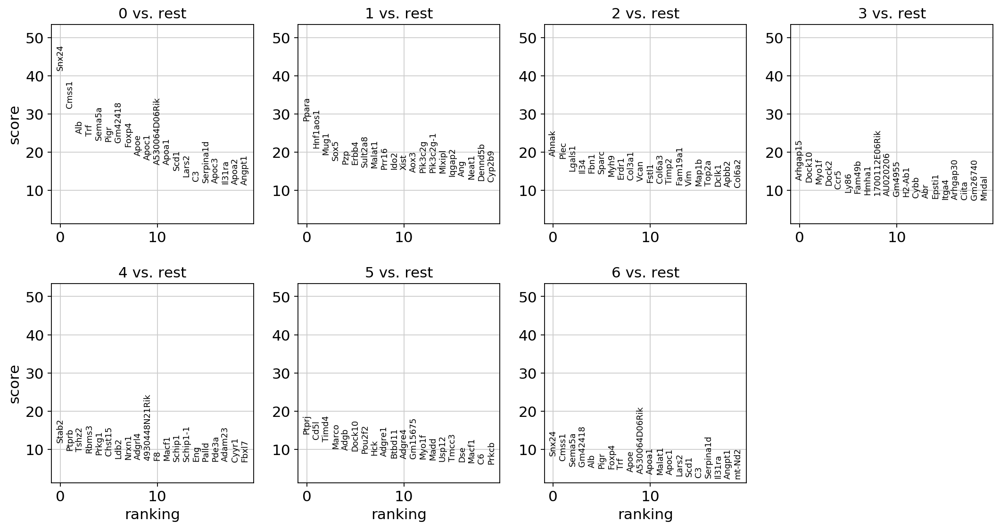

4


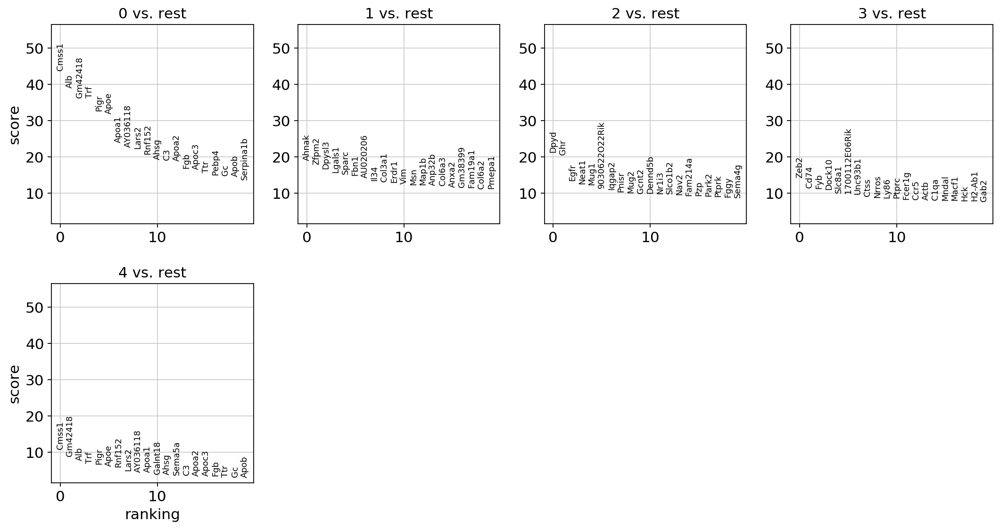

5


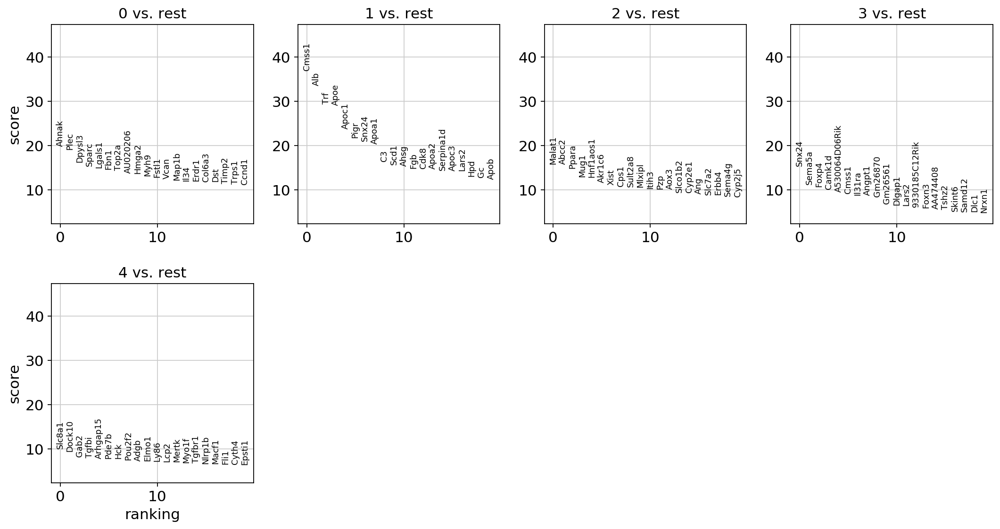

6


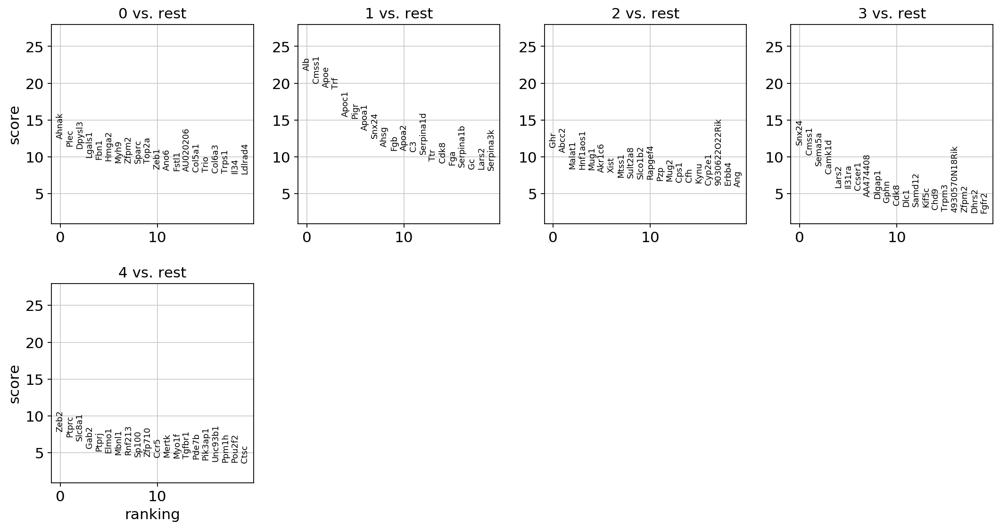

7


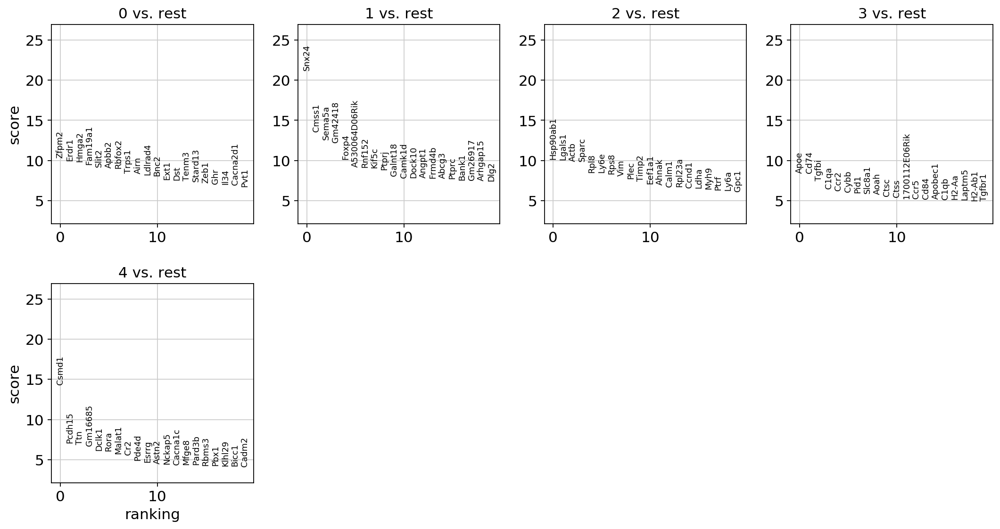

In [5]:
sc.settings.verbosity = 0
for exp in exps:
    sc.tl.rank_genes_groups(exps[exp]['adata_mouse'],groupby='leiden')
    print(exp)
    sc.pl.rank_genes_groups(exps[exp]['adata_mouse'])

/usr/local/lib/python3.6/dist-packages/anndata/core/anndata.py:846: FutureWarning: In anndata v0.7+, arrays contained within an AnnData object will maintain their dimensionality. For example, prior to v0.7 `adata[0, 0].X` returned a scalar and `adata[0, :]` returned a 1d array, post v0.7 they will return two dimensional arrays. If you would like to get a one dimensional array from your AnnData object, consider using the `adata.obs_vector`, `adata.var_vector` methods or accessing the array directly.
  warn_flatten()


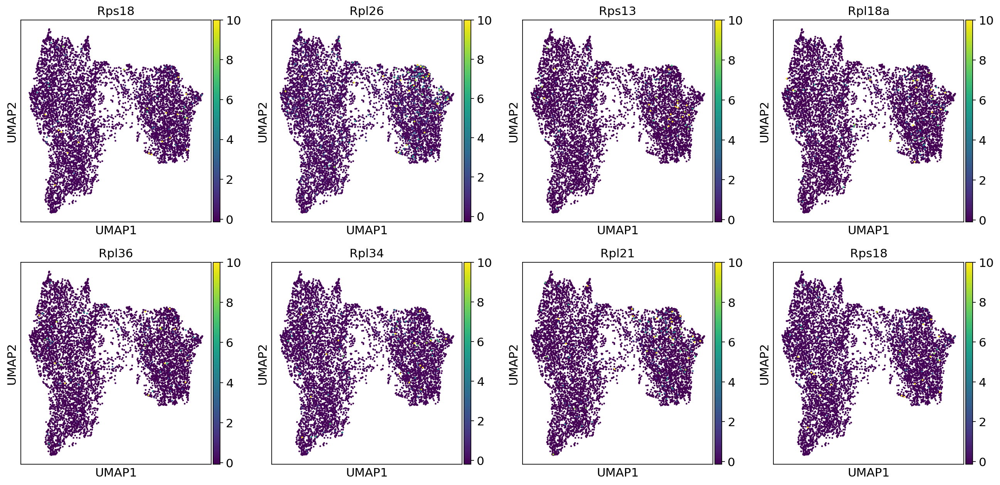

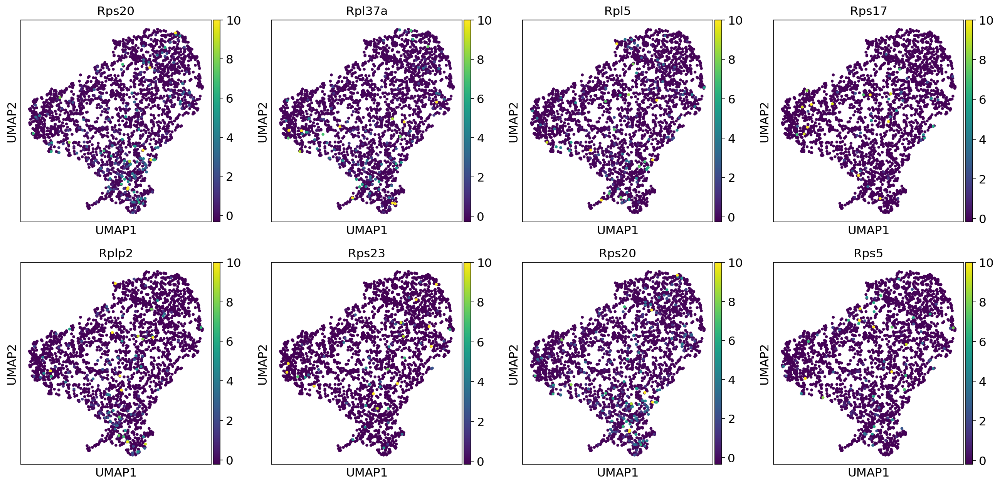

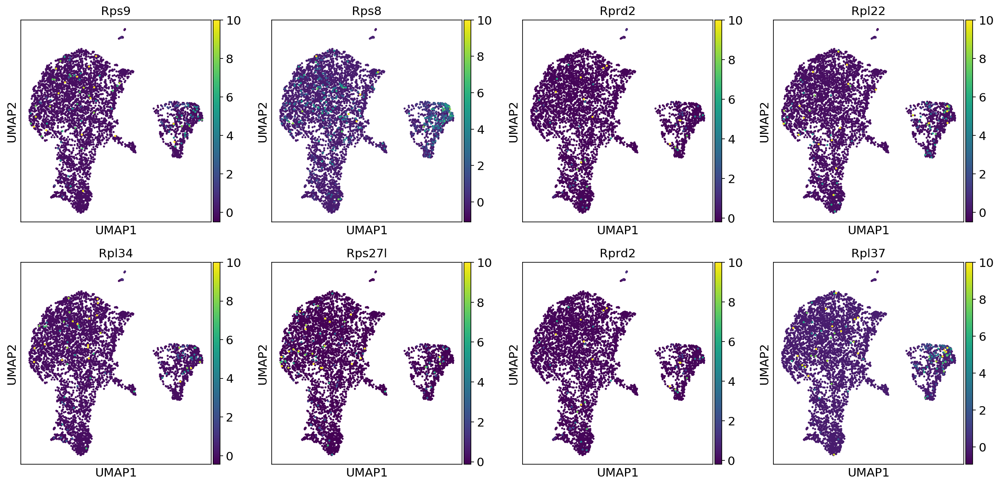

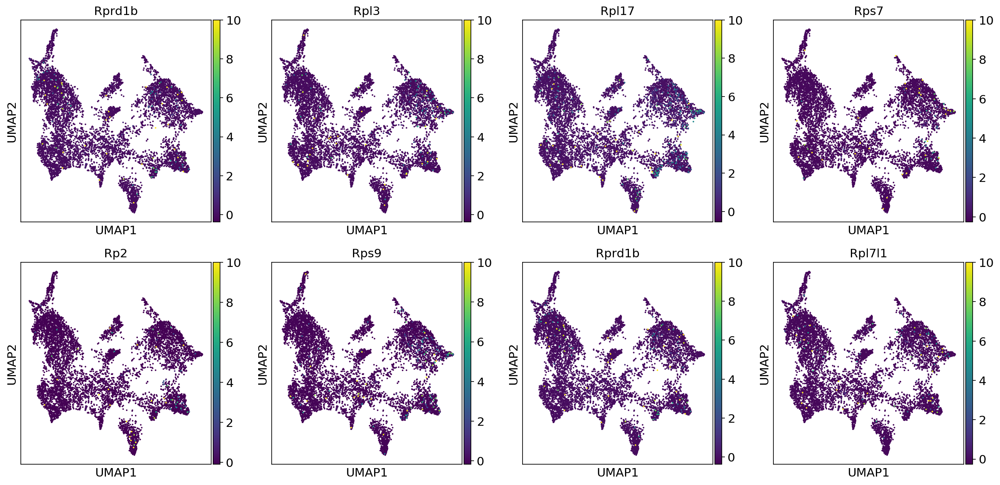

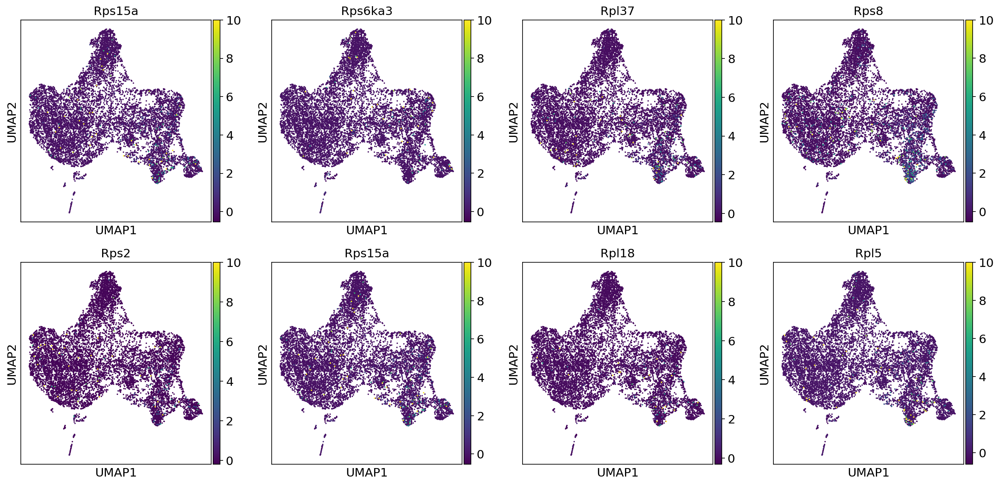

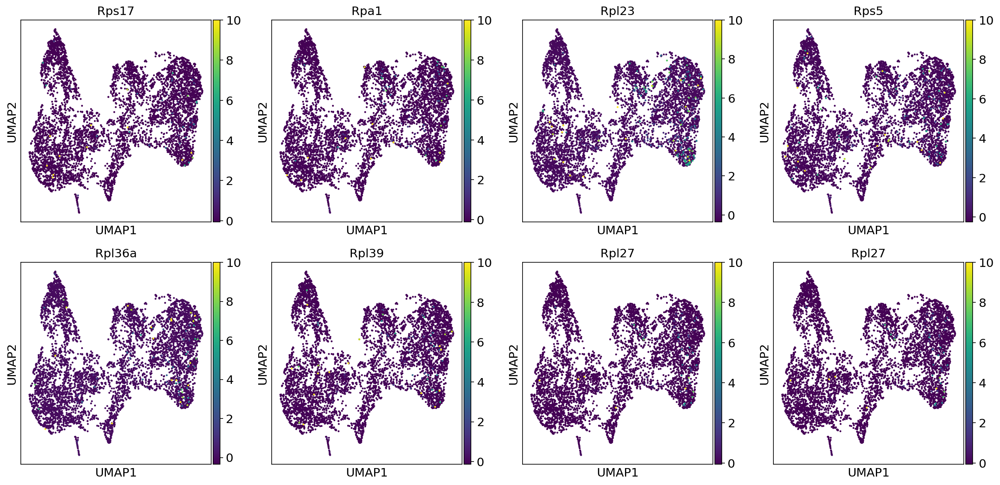

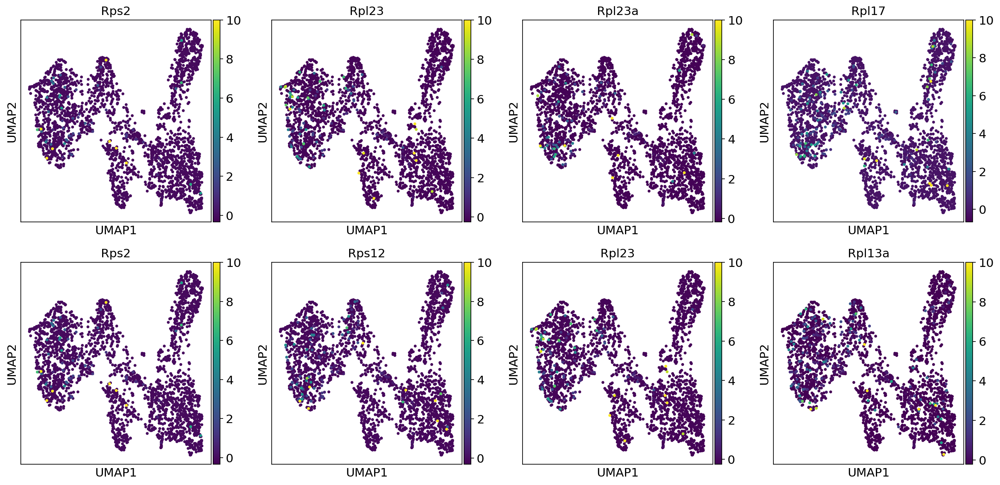

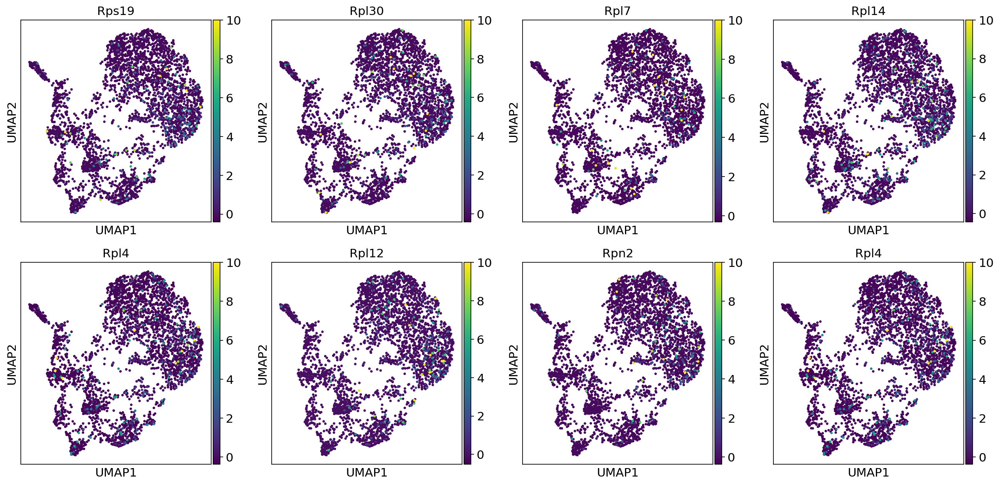

In [6]:
for exp in exps:
    fig, axes = plt.subplots(2,4,figsize=(20,9.5))
    for rp_gene, ax in zip(np.random.choice([i for i in exps[exp]['adata_mouse'].var_names if i.startswith('Rp')],8),np.ravel(axes)):
        sc.pl.umap(exps[exp]['adata_mouse'],color=rp_gene,ax=ax, return_fig=False, show=False)

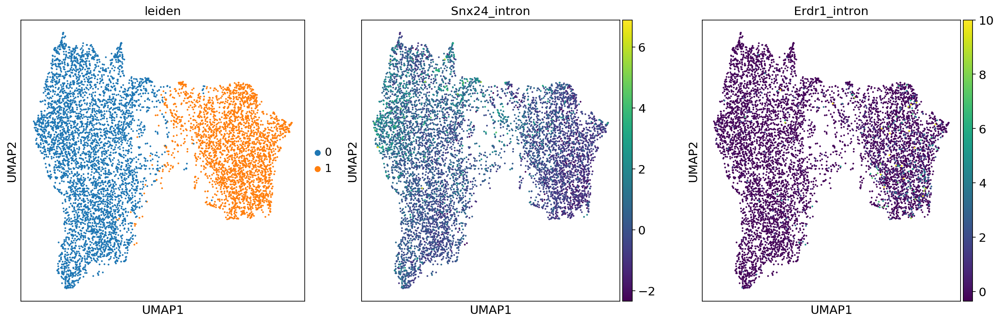

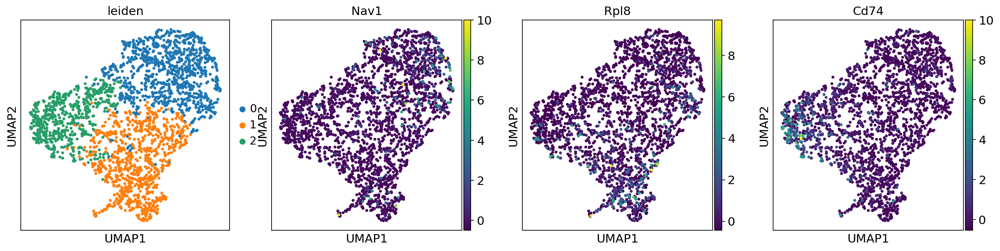

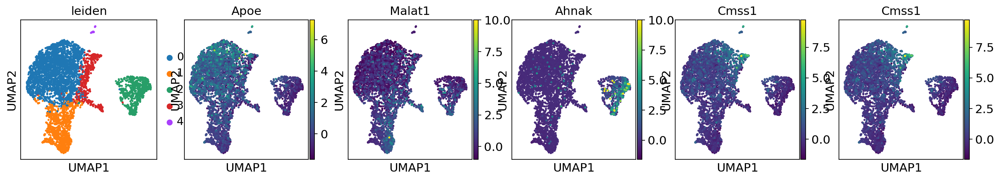

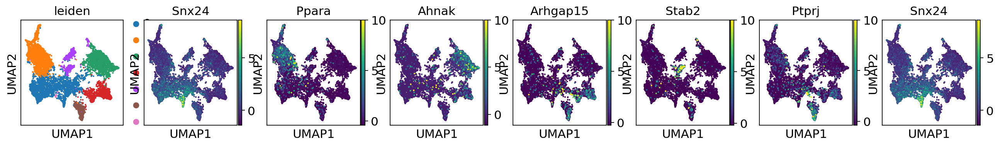

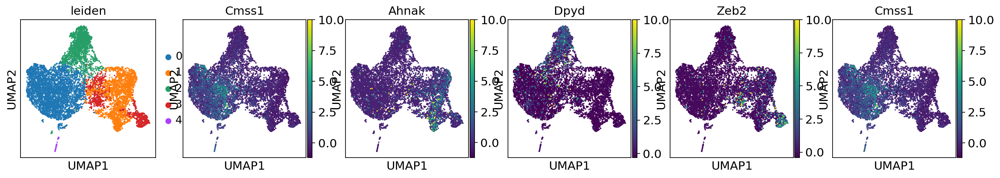

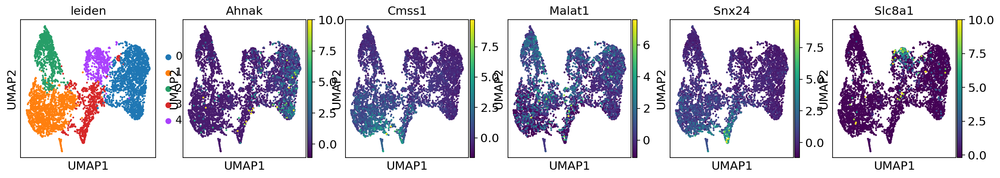

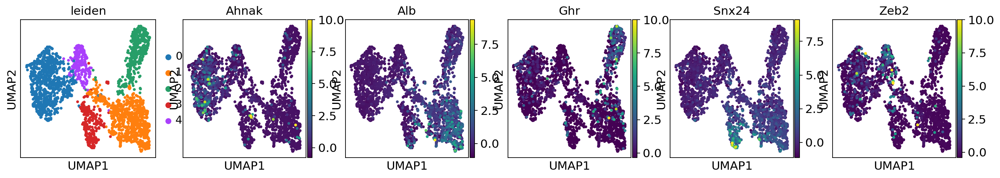

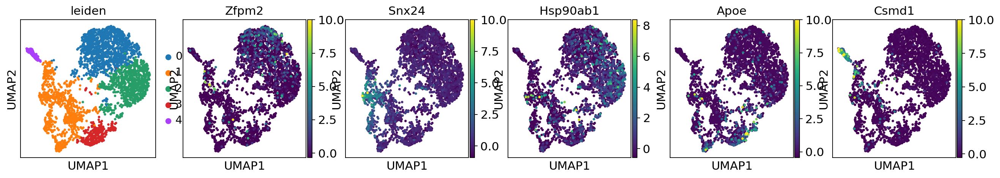

In [7]:
for exp in exps:
    genes = exps[exp]['adata_mouse'].uns['rank_genes_groups']['names'][0]
    fig, axes = plt.subplots(1,len(genes) + 1,figsize=(20,(4.5)*(4/(len(genes) + 1))))
    for feature, ax in zip(['leiden'] + list(genes), axes):
        sc.pl.umap(exps[exp]['adata_mouse'],color=feature,ax=ax, return_fig=False, show=False)

Data from Tabula Muris:

In [154]:
l_hep_genes = np.array(['0610005C13Rik', '0610007P14Rik', '1300017J02Rik', '1600014C10Rik', '2310039H08Rik', '4931406C07Rik', 'Aadac', 'Aadat', 'Abat', 'Abcb4', 'Abcd3', 'Abhd14b', 'Acaa1b', 'Acaa2', 'Acad11', 'Acadm', 'Acadvl', 'Acat1', 'Acat3', 'Acbd5', 'Aco1', 'Acox1', 'Acox2', 'Acsl1', 'Acsl5', 'Acsm1', 'Adh1', 'Adh5', 'Adi1', 'Adipor2', 'Adk', 'Aes', 'Afm', 'Agmat', 'Agt', 'Agxt', 'Ahcy', 'Ahsg', 'Ak2', 'Ak3', 'Akr1c13', 'Akr1c14', 'Akr1c6', 'Akr1d1', 'Akr7a5', 'Alad', 'Alb', 'Aldh1a1', 'Aldh1a7', 'Aldh1l1', 'Aldh2', 'Aldh6a1', 'Aldh7a1', 'Aldh8a1', 'Aldh9a1', 'Aldob', 'Amacr', 'Ambp', 'Amdhd1', 'Amy1', 'Ang', 'Angptl3', 'Angptl4', 'Apcs', 'Apoa1', 'Apoa2', 'Apoa4', 'Apoa5', 'Apob', 'Apoc1', 'Apoc3', 'Apoc4', 'Apof', 'Apoh', 'Apol7a', 'Apom', 'Apon', 'Aqp8', 'Arg1', 'Asgr1', 'Asgr2', 'Asl', 'Aspdh', 'Ass1', 'Atf5', 'Atp5a1', 'Atp5b', 'Atp5c1', 'Atp5d', 'Atp5f1', 'Atp5g1', 'Atp5g3', 'Atp5k', 'Atp5o', 'Azgp1', 'BC024386', 'Baat', 'Bbox1', 'Bche', 'Bckdha', 'Bdh1', 'Bhmt', 'Bhmt2', 'Bnip3', 'Bola3', 'Bphl', 'C1ra', 'C1rl', 'C3', 'C4b', 'C4bp', 'C8b', 'C8g', 'C9', 'Cald1', 'Car3', 'Cat', 'Cbr1', 'Cbs', 'Ccs', 'Cd302', 'Cdo1', 'Cebpa', 'Ces1c', 'Ces1d', 'Ces1e', 'Ces1f', 'Ces1g', 'Ces2a', 'Ces2e', 'Ces3a', 'Ces3b', 'Cfb', 'Cfh', 'Cfhr1', 'Cfhr2', 'Cfi', 'Chchd10', 'Cideb', 'Cisd1', 'Cldn3', 'Clpx', 'Clu', 'Cmbl', 'Col18a1', 'Comt', 'Cops6', 'Copz1', 'Cox5b', 'Cox6c', 'Cp', 'Cpb2', 'Cpn1', 'Cpox', 'Cpt2', 'Creb3l3', 'Crot', 'Crp', 'Csad', 'Cth', 'Cyb5b', 'Cyb5r3', 'Cyc1', 'Cyp1a2', 'Cyp27a1', 'Cyp2a12', 'Cyp2b9', 'Cyp2c29', 'Cyp2c37', 'Cyp2c40', 'Cyp2c44', 'Cyp2c50', 'Cyp2c54', 'Cyp2c68', 'Cyp2c69', 'Cyp2c70', 'Cyp2d10', 'Cyp2d26', 'Cyp2e1', 'Cyp2f2', 'Cyp2j5', 'Cyp3a11', 'Cyp3a13', 'Cyp3a25', 'Cyp4a10', 'Cyp4f14', 'Cyp4v3', 'Cyp51', 'Cyp8b1', 'Dap', 'Dbi', 'Dbt', 'Dcaf11', 'Dcxr', 'Ddah1', 'Ddc', 'Ddt', 'Decr1', 'Decr2', 'Dgat2', 'Dhcr24', 'Dhrs1', 'Dhrs4', 'Dio1', 'Dmgdh', 'Dpyd', 'Dpys', 'Ebp', 'Ebpl', 'Ech1', 'Echdc2', 'Echs1', 'Eci1', 'Eci2', 'Egfr', 'Ehhadh', 'Elovl2', 'Elovl5', 'Ephx2', 'Errfi1', 'Etfa', 'Etfb', 'Etfdh', 'Ethe1', 'Etnk2', 'F10', 'F12', 'F13b', 'F2', 'F5', 'F7', 'F9', 'Faah', 'Fabp1', 'Fabp2', 'Fads1', 'Fah', 'Fahd1', 'Fam25c', 'Fbp1', 'Fdps', 'Fdx1', 'Fetub', 'Fga', 'Fgb', 'Fgg', 'Fgl1', 'Fh1', 'Fkbp4', 'Fmo1', 'Fn1', 'Fpgs', 'Ftcd', 'Fxyd1', 'G6pc', 'Gabarapl1', 'Gadd45gip1', 'Galm', 'Gamt', 'Gc', 'Gcat', 'Gcdh', 'Gcgr', 'Gch1', 'Gchfr', 'Gckr', 'Gclc', 'Gclm', 'Gcsh', 'Gfer', 'Ghr', 'Gjb1', 'Gjb2', 'Gldc', 'Glo1', 'Glrx5', 'Gls2', 'Glud1', 'Glyat', 'Gm4952', 'Gnmt', 'Got2', 'Gpd1', 'Gpld1', 'Gpt2', 'Gpx1', 'Grhpr', 'Gsta3', 'Gstp1', 'Gstt1', 'Gstz1', 'Gulo', 'H2-Q10', 'H6pd', 'Haao', 'Hacl1', 'Hadh', 'Hadha', 'Hagh', 'Hal', 'Hamp', 'Hamp2', 'Hao1', 'Hc', 'Hdlbp', 'Hebp1', 'Hgd', 'Hgfac', 'Hibadh', 'Higd1a', 'Hint2', 'Hist1h2bc', 'Hmgcl', 'Hmgcs1', 'Hmgcs2', 'Hnf4a', 'Hp', 'Hpd', 'Hpn', 'Hpx', 'Hrg', 'Hsd11b1', 'Hsd17b13', 'Hsd17b2', 'Hsd17b4', 'Hsd3b3', 'Hsdl2', 'Hspa9', 'Hspb8', 'Hspd1', 'Iah1', 'Idh1', 'Igf1', 'Igfals', 'Igfbp1', 'Igfbp2', 'Il1rap', 'Inmt', 'Insig1', 'Insig2', 'Itih1', 'Itih2', 'Itih3', 'Itih4', 'Iyd', 'Keg1', 'Khk', 'Klf15', 'Klkb1', 'Kmo', 'Kng1', 'Kng2', 'Kynu', 'Lap3', 'Lcat', 'Ldha', 'Leap2', 'Lect2', 'Lgals9', 'Lipc', 'Lonp2', 'Lrg1', 'Lsr', 'Lypla1', 'Maob', 'Masp2', 'Mat1a', 'Mbl1', 'Mbl2', 'Mdh1', 'Mettl7a1', 'Mettl7b', 'Mgst1', 'Mlxipl', 'Mlycd', 'Mrpl12', 'Mrpl15', 'Msra', 'Mst1', 'Mtch2', 'Mthfd1', 'Mug1', 'Mug2', 'Mup20', 'Mup3', 'Ndrg2', 'Ndufa1', 'Ndufa11', 'Ndufa13', 'Ndufa4', 'Ndufb9', 'Ndufs6', 'Ndufv1', 'Ndufv2', 'Ndufv3', 'Nipsnap1', 'Nit2', 'Nnmt', 'Nr1h4', 'Nrn1', 'Nudt4', 'Nudt7', 'Oaf', 'Orm1', 'Osbpl1a', 'Otc', 'P4hb', 'Pah', 'Paics', 'Pank1', 'Papss2', 'Paqr9', 'Park7', 'Pbld2', 'Pcbd1', 'Pccb', 'Pck1', 'Pcyt2', 'Pecr', 'Pemt', 'Pgm2', 'Pgrmc1', 'Phb2', 'Phyh', 'Pigr', 'Pink1', 'Pipox', 'Plg', 'Pmvk', 'Pnpla7', 'Pnpo', 'Pon1', 'Ppa1', 'Ppm1b', 'Prdx1', 'Prdx4', 'Prdx6', 'Prlr', 'Proc', 'Prodh2', 'Proz', 'Psmb7', 'Pter', 'Ptms', 'Pxmp2', 'Pygl', 'Pzp', 'Qdpr', 'Rapgef4', 'Rarres2', 'Rbp4', 'Rcl1', 'Rdh7', 'Rdx', 'Reep6', 'Retsat', 'Rgn', 'Rnase4', 'Rnf128', 'Rps27l', 'Sar1b', 'Sardh', 'Sc5d', 'Scd1', 'Scp2', 'Sdc2', 'Sdc4', 'Sdha', 'Sdhb', 'Sdhc', 'Sdhd', 'Sds', 'Sec14l2', 'Sec14l4', 'Selenbp1', 'Selenbp2', 'Sema4g', 'Sephs2', 'Serpina10', 'Serpina12', 'Serpina1a', 'Serpina1b', 'Serpina1c', 'Serpina1d', 'Serpina1e', 'Serpina3k', 'Serpina3m', 'Serpina3n', 'Serpina6', 'Serpinc1', 'Serpind1', 'Serpinf1', 'Serpinf2', 'Serping1', 'Sfxn1', 'Shmt1', 'Shmt2', 'Slc10a1', 'Slc17a2', 'Slc22a1', 'Slc22a18', 'Slc22a30', 'Slc25a1', 'Slc25a13', 'Slc25a15', 'Slc25a39', 'Slc25a47', 'Slc27a2', 'Slc27a5', 'Slc31a1', 'Slc38a3', 'Slc38a4', 'Slc6a13', 'Slco1b2', 'Sod1', 'Sod2', 'Sord', 'Spp2', 'Spr', 'Sqrdl', 'Stard10', 'Sucla2', 'Suclg1', 'Suclg2', 'Sult1a1', 'Sult1d1', 'Tars', 'Tat', 'Tcea3', 'Tdo2', 'Tecr', 'Tfpi2', 'Tfr2', 'Thrsp', 'Timd2', 'Tm4sf4', 'Tm7sf2', 'Tmem150a', 'Tmem205', 'Tmem37', 'Tmem38b', 'Tmem56', 'Tmprss6', 'Tpi1', 'Tprkb', 'Trap1', 'Trf', 'Tspan31', 'Tst', 'Ttc36', 'Ttc39c', 'Ttpa', 'Ttr', 'Tuba4a', 'Tubb2a', 'Txn2', 'Ugp2', 'Ugt2a3', 'Ugt2b1', 'Ugt2b34', 'Ugt2b35', 'Ugt2b36', 'Ugt2b5', 'Ugt3a2', 'Uox', 'Upb1', 'Uqcr11', 'Uqcrc1', 'Uqcrfs1', 'Uqcrq', 'Usmg5', 'Vkorc1', 'Vtn', 'Zfand6'])
l_endo_hep_sinu_genes = np.array(['1810011O10Rik', 'Actn4', 'Adamts1', 'App', 'Aqp1', 'Bgn', 'Bmp2', 'Calm2', 'Cd300lg', 'Cd36', 'Cd38', 'Cd55', 'Cd59a', 'Cdh5', 'Cldn5', 'Clec14a', 'Clec4g', 'Clic4', 'Cmtm8', 'Col13a1', 'Col4a1', 'Col4a2', 'Ctla2a', 'Ctsl', 'Cyp4b1', 'Dab2', 'Degs1', 'Dlc1', 'Dnase1l3', 'Dpp4', 'Dusp1', 'Dynll1', 'Egfl7', 'Ehd3', 'Elf1', 'Elk3', 'Eng', 'Epas1', 'Esam', 'Ets1', 'F8', 'Fabp4', 'Fam167b', 'Fcgr2b', 'Fcgrt', 'Fkbp1a', 'Flt1', 'Flt4', 'Fos', 'Fscn1', 'Fyn', 'Gatm', 'Gimap4', 'Gimap6', 'Gng11', 'Gpihbp1', 'Gpr182', 'Hes1', 'Icam2', 'Ifi203', 'Ifi204', 'Ifitm2', 'Ifitm3', 'Igfbp4', 'Igfbp7', 'Il6st', 'Jak1', 'Jun', 'Jund', 'Kdr', 'Klf2', 'Klf4', 'Lifr', 'Ltbp4', 'Lyve1', 'Maf', 'Marcksl1', 'Mgll', 'Mmrn2', 'Mndal', 'Mrc1', 'Mtch1', 'Myct1', 'Npr1', 'Nrp1', 'Nucb1', 'Oit3', 'Pdlim1', 'Pea15a', 'Pecam1', 'Plk2', 'Plxnc1', 'Ppp1r15a', 'Ppp1r2', 'Ptprb', 'Ramp2', 'Rasip1', 'Rbms1', 'Rfk', 'Rhob', 'Rhoc', 'Robo4', 'Rtp4', 'S100a13', 'Sdpr', 'Serinc3', 'Sgk1', 'Sgpp1', 'Sh3bp5', 'Slc29a1', 'Slc39a8', 'Slc43a3', 'Slc9a3r2', 'Snrk', 'Sparc', 'Srsf2', 'Stab1', 'Stab2', 'Sypl', 'Tcn2', 'Tek', 'Tfpi', 'Timp3', 'Tinagl1', 'Tm4sf1', 'Tmem106a', 'Tmem204', 'Tmem30a', 'Tnfaip1', 'Tspan7', 'Txnip', 'Ushbp1', 'Ywhab'])
l_b_genes = np.array(['Arhgdib', 'Cd48', 'Cd52', 'Cd53', 'Cd74', 'Celf2', 'Cotl1', 'Crip1', 'Emp3', 'H3f3a', 'Hnrnpc', 'Mbnl1', 'Ncl', 'Pabpc1', 'Peli1', 'Plac8', 'Ppia', 'Ptma', 'Ptpn18', 'Ptprc', 'Rac2', 'Rgs2', 'Rpl10', 'Rpl10a', 'Rpl11', 'Rpl12', 'Rpl13', 'Rpl13a', 'Rpl15', 'Rpl17', 'Rpl18', 'Rpl18a', 'Rpl19', 'Rpl21', 'Rpl22', 'Rpl23', 'Rpl23a', 'Rpl27', 'Rpl27a', 'Rpl28', 'Rpl3', 'Rpl32', 'Rpl35', 'Rpl36', 'Rpl37', 'Rpl37a', 'Rpl38', 'Rpl39', 'Rpl41', 'Rpl6', 'Rpl7', 'Rpl8', 'Rpl9', 'Rplp0', 'Rplp1', 'Rplp2', 'Rps10', 'Rps12', 'Rps13', 'Rps14', 'Rps15', 'Rps15a', 'Rps16', 'Rps18', 'Rps19', 'Rps2', 'Rps20', 'Rps21', 'Rps23', 'Rps24', 'Rps26', 'Rps27', 'Rps27a', 'Rps3', 'Rps4x', 'Rps5', 'Rps7', 'Rpsa', 'Selplg', 'Sh3bgrl3', 'Shisa5', 'Snrpg', 'Stk17b', 'Stk24', 'Tmsb10'])        
l_b_genes_no_RP = np.array(['Arhgdib', 'Cd48', 'Cd52', 'Cd53', 'Cd74', 'Celf2', 'Cotl1', 'Crip1', 'Emp3', 'H3f3a', 'Hnrnpc', 'Mbnl1', 'Ncl', 'Pabpc1', 'Peli1', 'Plac8', 'Ppia', 'Ptma', 'Ptpn18', 'Ptprc', 'Rac2', 'Rgs2', 'Selplg', 'Sh3bgrl3', 'Shisa5', 'Snrpg', 'Stk17b', 'Stk24', 'Tmsb10'])

s_b_genes = np.array(['Aldh2', 'Apobec3', 'Arpc5l', 'Bank1', 'Bin1', 'Blnk', 'Capg', 'Cd19', 'Cd22', 'Cd24a', 'Cd37', 'Cd55', 'Cd72', 'Cd74', 'Cd79a', 'Cd79b', 'Cd83', 'Chchd10', 'Cr2', 'Csk', 'Ctsh', 'Dok3', 'Fcer2a', 'Fcrl1', 'Fcrla', 'Foxp1', 'Gga2', 'Gpr18', 'H2-Aa', 'H2-Ab1', 'H2-DMa', 'H2-Eb1', 'H2-Oa', 'H2-Ob', 'H3f3a', 'Hmgn1', 'Hvcn1', 'Id3', 'Irf8', 'Lat2', 'Ly6a', 'Ly6d', 'Ly6e', 'Ly86', 'Mef2c', 'Ms4a1', 'Ms4a4c', 'Napsa', 'Pkig', 'Plac8', 'Pold4', 'Pou2f2', 'Ptp4a3', 'Ptpn6', 'Ralgps2', 'Serinc3', 'Serp1', 'Serpinb1a', 'Sh3bp5', 'Siglecg', 'Snn', 'Snx2', 'Spib', 'Tmem123', 'Tnfrsf13c', 'Unc93b1', 'Vpreb3'])
s_t_genes = np.array(['Actn1', 'Atp1b3', 'B4galnt1', 'Ccnd2', 'Ccr7', 'Cd247', 'Cd27', 'Cd3d', 'Cd3e', 'Cd3g', 'Cd8a', 'Cd8b1', 'Ctsw', 'Dapl1', 'Dgka', 'Dnajc15', 'Emb', 'Fam189b', 'Fxyd5', 'Fyb', 'Gimap3', 'Gimap4', 'Hcst', 'Id2', 'Ifi47', 'Itgb7', 'Lat', 'Lck', 'Leprotl1', 'Ms4a4b', 'Ms4a6b', 'Nkg7', 'Prkcq', 'Rgs10', 'Rps6', 'S100a10', 'Selplg', 'Skap1', 'Slfn1', 'Smc4', 'Tcf7', 'Thy1'])
s_mphage_genes = np.array(['Apbb1ip', 'Ctsd', 'Cyba', 'Fcer1g', 'Fcgr3', 'Hpcal1', 'Id2', 'Itgb2', 'Itm2b', 'Itm2c', 'Laptm5', 'Nptn', 'Ptms', 'Rnaset2b', 'Sat1', 'Sdcbp', 'Sdf2l1', 'Smpdl3a', 'Tnfrsf1b', 'Txn1', 'Tyrobp'])

MC38 genes from https://www.ncbi.nlm.nih.gov/pmc/articles/PMC5750210/, https://www.cell.com/cell-reports/pdfExtended/S2211-1247(18)31636-X:

In [155]:
mc38_genes = np.array(['Atad2', 'Rqcd1', 'Spag9', 'Pbk', 'Ctage5', 'Odf2', 'Casc5', 'Tmeff1', 'Dcaf12', 'Cep55', 'Fam159b', 'Snhg9'])
immune_genes = np.array(['Cd3d','Il7r','Lyz1','Ank3','Cd8b1','Ptprc', 'Cd19','Ms4a1','Cd79a'])

In [156]:
print(len(np.intersect1d(np.intersect1d(l_hep_genes, l_endo_hep_sinu_genes),l_b_genes)) == 0) # confirm none are overlapping
print(len(np.intersect1d(np.intersect1d(s_b_genes, s_t_genes),s_mphage_genes)) == 0) # confirm none are overlapping

True
True


In [157]:
for exp in range(7):
    exps[exp]['mouse_l_hep_genes'] = np.intersect1d(l_hep_genes, exps[exp]['adata_mouse'].var_names.values)
    exps[exp]['mouse_l_ehs_genes'] = np.intersect1d(l_endo_hep_sinu_genes, exps[exp]['adata_mouse'].var_names.values)
    exps[exp]['mouse_l_b_genes'] = np.intersect1d(l_b_genes_no_RP, exps[exp]['adata_mouse'].var_names.values) # using the non-Ribo genes
    exps[exp]['mouse_mc38_genes'] = np.intersect1d(mc38_genes, exps[exp]['adata_mouse'].var_names.values)
    exps[exp]['mouse_immune_genes'] = np.intersect1d(immune_genes, exps[exp]['adata_mouse'].var_names.values)
    
for exp in [7]: # the only spleen sample
    exps[exp]['mouse_s_b_genes'] = np.intersect1d(s_b_genes, exps[exp]['adata_mouse'].var_names.values)
    exps[exp]['mouse_s_t_genes'] = np.intersect1d(s_t_genes, exps[exp]['adata_mouse'].var_names.values)
    exps[exp]['mouse_s_mphage_genes'] = np.intersect1d(s_mphage_genes, exps[exp]['adata_mouse'].var_names.values)
    exps[exp]['mouse_mc38_genes'] = np.intersect1d(mc38_genes, exps[exp]['adata_mouse'].var_names.values)
    exps[exp]['mouse_immune_genes'] = np.intersect1d(immune_genes, exps[exp]['adata_mouse'].var_names.values)

In [158]:
for exp in range(7):
    label = 'mouse_l_hep_genes'
    vals = exps[exp]['adata_mouse'][:,exps[exp][label]].X
    if len(vals.shape) == 1:
        sums = vals
    else:
        sums = vals.sum(axis=1).toarray()
    exps[exp]['adata_mouse'].obs['hep_score'] = sums/len(exps[exp][label])
    
    label = 'mouse_l_ehs_genes'
    vals = exps[exp]['adata_mouse'][:,exps[exp][label]].X
    if len(vals.shape) == 1:
        sums = vals
    else:
        sums = vals.sum(axis=1).toarray()
    exps[exp]['adata_mouse'].obs['ehs_score'] = sums/len(exps[exp][label])
    
    label = 'mouse_l_b_genes'
    vals = exps[exp]['adata_mouse'][:,exps[exp][label]].X
    if len(vals.shape) == 1:
        sums = vals
    else:
        sums = vals.sum(axis=1).toarray()
    exps[exp]['adata_mouse'].obs['b_score'] = sums/len(exps[exp][label])
    
    label = 'mouse_mc38_genes'
    vals = exps[exp]['adata_mouse'][:,exps[exp][label]].X
    if len(vals.shape) == 1:
        sums = vals
    else:
        sums = vals.sum(axis=1).toarray()
    exps[exp]['adata_mouse'].obs['mc38_score'] = sums/len(exps[exp][label])
    
    label = 'mouse_immune_genes'
    vals = exps[exp]['adata_mouse'][:,exps[exp][label]].X
    if len(vals.shape) == 1:
        sums = vals
    else:
        sums = vals.sum(axis=1).toarray()
    exps[exp]['adata_mouse'].obs['immune_score'] = sums/len(exps[exp][label])

for exp in [7]:
    
    label = 'mouse_s_b_genes'
    vals = exps[exp]['adata_mouse'][:,exps[exp][label]].X
    if len(vals.shape) == 1:
        sums = vals
    else:
        sums = vals.sum(axis=1).toarray()
    exps[exp]['adata_mouse'].obs['b_score'] = sums/len(exps[exp][label])
    
    label = 'mouse_s_t_genes'
    vals = exps[exp]['adata_mouse'][:,exps[exp][label]].X
    if len(vals.shape) == 1:
        sums = vals
    else:
        sums = vals.sum(axis=1).toarray()
    exps[exp]['adata_mouse'].obs['t_score'] = sums/len(exps[exp][label])
    
    label = 'mouse_s_mphage_genes'
    vals = exps[exp]['adata_mouse'][:,exps[exp][label]].X
    if len(vals.shape) == 1:
        sums = vals
    else:
        sums = vals.sum(axis=1).toarray()
    exps[exp]['adata_mouse'].obs['mphage_score'] = sums/len(exps[exp][label])
    
    label = 'mouse_mc38_genes'
    vals = exps[exp]['adata_mouse'][:,exps[exp][label]].X
    if len(vals.shape) == 1:
        sums = vals
    else:
        sums = vals.sum(axis=1).toarray()
    exps[exp]['adata_mouse'].obs['mc38_score'] = sums/len(exps[exp][label])
    
    label = 'mouse_immune_genes'
    vals = exps[exp]['adata_mouse'][:,exps[exp][label]].X
    if len(vals.shape) == 1:
        sums = vals
    else:
        sums = vals.sum(axis=1).toarray()
    exps[exp]['adata_mouse'].obs['immune_score'] = sums/len(exps[exp][label])

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:33: RuntimeWarning: invalid value encountered in true_divide
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:41: RuntimeWarning: invalid value encountered in true_divide


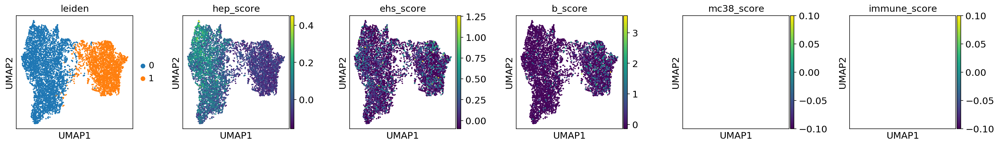

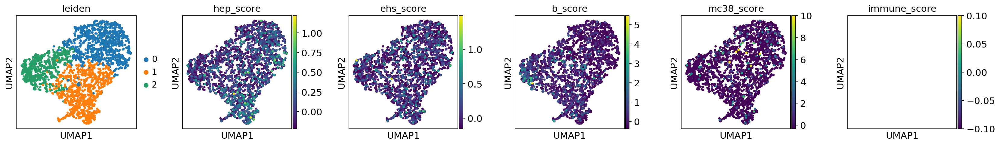

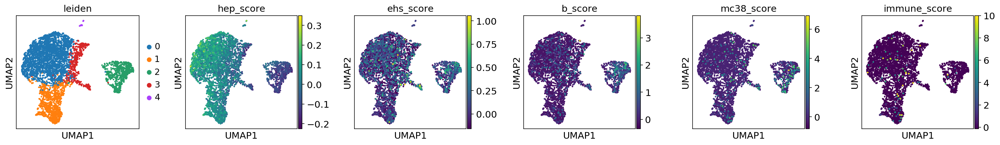

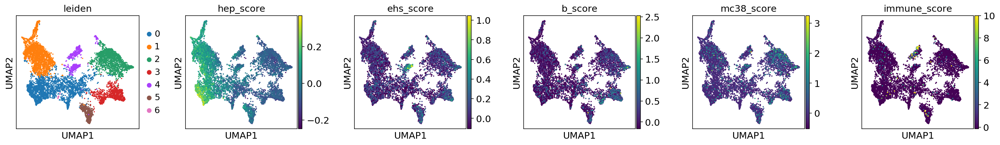

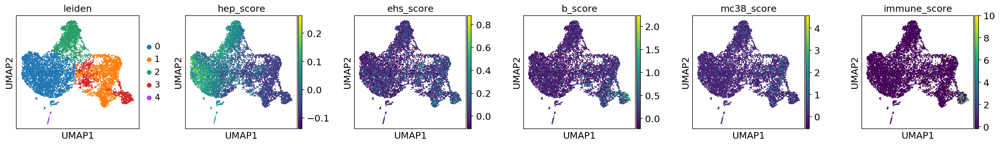

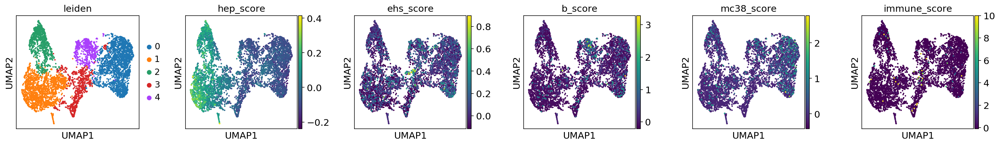

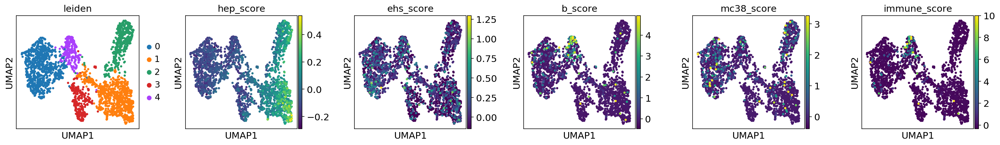

In [166]:
for exp in range(7):
    fig, axes = plt.subplots(1,6,figsize=(21,3.25))
    for feature, ax in zip(['leiden', 'hep_score','ehs_score','b_score','mc38_score','immune_score'], axes):
        sc.pl.umap(exps[exp]['adata_mouse'],color=feature,ax=ax, return_fig=False, show=False)
    plt.tight_layout()

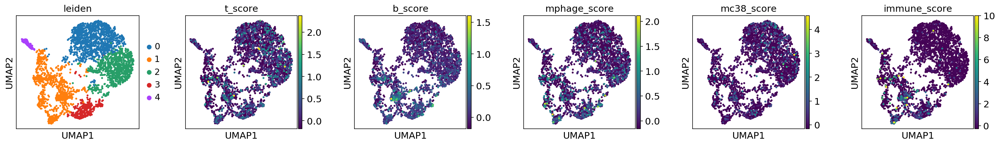

In [168]:
for exp in [7]:
    fig, axes = plt.subplots(1,6,figsize=(21,3.25))
    for feature, ax in zip(['leiden', 't_score','b_score','mphage_score','mc38_score','immune_score'], axes):
        sc.pl.umap(exps[exp]['adata_mouse'],color=feature,ax=ax, return_fig=False, show=False)
    plt.tight_layout()